# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [1]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

Archive:  processed-celeba-small.zip
   creating: processed_celeba_small/
  inflating: processed_celeba_small/.DS_Store  
   creating: __MACOSX/
   creating: __MACOSX/processed_celeba_small/
  inflating: __MACOSX/processed_celeba_small/._.DS_Store  
   creating: processed_celeba_small/celeba/
  inflating: processed_celeba_small/celeba/.DS_Store  
   creating: __MACOSX/processed_celeba_small/celeba/
  inflating: __MACOSX/processed_celeba_small/celeba/._.DS_Store  
  inflating: processed_celeba_small/celeba/161979.jpg  
  inflating: processed_celeba_small/celeba/161980.jpg  
  inflating: processed_celeba_small/celeba/161981.jpg  
  inflating: processed_celeba_small/celeba/161982.jpg  
  inflating: processed_celeba_small/celeba/161983.jpg  
  inflating: processed_celeba_small/celeba/161984.jpg  
  inflating: processed_celeba_small/celeba/161985.jpg  
  inflating: processed_celeba_small/celeba/161986.jpg  
  inflating: processed_celeba_small/celeba/161987.jpg  
  inflating: processed_celeb

In [2]:
from glob import glob
from pathlib import Path
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import (Compose, Normalize, RandomHorizontalFlip,
                                    Resize, ToTensor)

import tests


In [3]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [4]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    height, width = size
    transforms = [
        Resize((height, width)),
        RandomHorizontalFlip(p=0.5),
        ToTensor(),
        Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    ]

    return Compose(transforms)


### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [5]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self,
                 directory: str,
                 transforms: Callable = None,
                 extension: str = '.jpg'):
        # TODO: implement the init method
        self.directory = Path(directory)
        self.extension = extension if extension.startswith('.') else f'.{extension}'
        self.transforms = transforms if transforms is not None else Compose([ToTensor()])
        all_files = glob(str(self.directory / '*'))
        self.image_paths = sorted(
            path for path in all_files if Path(path).suffix.lower() == self.extension.lower()
        )

    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.image_paths)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        image_path = self.image_paths[index]
        with Image.open(image_path) as img:
            img = img.convert('RGB')
        if self.transforms is not None:
            img = self.transforms(img)
        return img


In [6]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

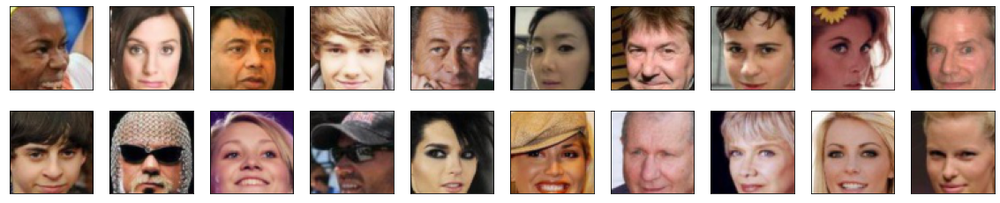

In [7]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [8]:
from torch.nn import Module

In [9]:
class Discriminator(Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        feature_maps = 64
        self.net = nn.Sequential(
            nn.Conv2d(3, feature_maps, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(feature_maps, feature_maps * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(feature_maps * 2, feature_maps * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(feature_maps * 4, feature_maps * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(feature_maps * 8, 1, kernel_size=4, stride=1, padding=0)
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
        return self.net(x)


In [9]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [10]:
class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
        # TODO: instantiate the different layers
        feature_maps = 64
        self.net = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, feature_maps * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(feature_maps * 8),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(feature_maps * 8, feature_maps * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps * 4),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(feature_maps * 4, feature_maps * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps * 2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(feature_maps * 2, feature_maps, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_maps),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(feature_maps, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
        return self.net(x)


In [11]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [12]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):
    """ This function should return the optimizers of the generator and the discriminator """
    # TODO: implement the generator and discriminator optimizers
    lr = 2e-4
    betas = (0.5, 0.999)
    g_optimizer = optim.Adam(generator.parameters(), lr=lr, betas=betas)
    d_optimizer = optim.Adam(discriminator.parameters(), lr=lr, betas=betas)
    return g_optimizer, d_optimizer


## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [13]:
def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    # TODO: implement the generator loss
    return -fake_logits.view(fake_logits.size(0), -1).mean()


### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [14]:
def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
    # TODO: implement the discriminator loss
    real_score = real_logits.view(real_logits.size(0), -1).mean()
    fake_score = fake_logits.view(fake_logits.size(0), -1).mean()
    return fake_score - real_score


### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [15]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ Enforce the 1-Lipschitz constraint via gradient penalty. """
    batch_size = real_samples.size(0)
    device = real_samples.device
    eps = torch.rand(batch_size, 1, 1, 1, device=device)
    interpolates = (eps * real_samples + (1 - eps) * fake_samples).requires_grad_(True)
    mixed_scores = discriminator(interpolates)
    grad_outputs = torch.ones_like(mixed_scores)
    gradients = torch.autograd.grad(
        outputs=mixed_scores,
        inputs=interpolates,
        grad_outputs=grad_outputs,
        create_graph=True,
        retain_graph=True,
        only_inputs=True
    )[0]
    gradients = gradients.view(batch_size, -1)
    gp = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gp

GP_WEIGHT = 10.0


## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [16]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    g_optimizer.zero_grad(set_to_none=True)
    fake_images = generator(noise)
    fake_logits = discriminator(fake_images)
    g_loss = generator_loss(fake_logits)
    g_loss.backward()
    g_optimizer.step()
    return {'loss': g_loss.detach()}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)
    d_optimizer.zero_grad(set_to_none=True)
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    with torch.no_grad():
        fake_images = generator(noise)
    fake_logits = discriminator(fake_images.detach())
    real_logits = discriminator(real_images)
    wasserstein = discriminator_loss(real_logits, fake_logits)
    gp = gradient_penalty(discriminator, real_images, fake_images.detach())
    total_loss = wasserstein + GP_WEIGHT * gp
    total_loss.backward()
    d_optimizer.step()
    return {
        'loss': total_loss.detach(),
        'gp': (GP_WEIGHT * gp).detach(),
        'wasserstein': wasserstein.detach()
    }


### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [24]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 64


In [ ]:
# # you can experiment with different dimensions of latent spaces
# latent_dim = 128

# # update to cpu if you do not have access to a gpu
# device = 'cuda'

# # number of epochs to train your model
# n_epochs = 1

# # number of images in each batch
# batch_size = 64

In [25]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [26]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

In [17]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU")


True
Tesla T4


2025-11-14 21:29:45 | Epoch [1/50] | Batch 0/509 | d_loss: 2.4094 | g_loss: 1.4985
2025-11-14 21:29:52 | Epoch [1/50] | Batch 50/509 | d_loss: -136.6173 | g_loss: 68.1369
2025-11-14 21:29:59 | Epoch [1/50] | Batch 100/509 | d_loss: -162.7137 | g_loss: 83.3891
2025-11-14 21:30:07 | Epoch [1/50] | Batch 150/509 | d_loss: -239.1391 | g_loss: 96.1919
2025-11-14 21:30:15 | Epoch [1/50] | Batch 200/509 | d_loss: -424.1366 | g_loss: 203.5636
2025-11-14 21:30:23 | Epoch [1/50] | Batch 250/509 | d_loss: -44.0326 | g_loss: 135.0173
2025-11-14 21:30:32 | Epoch [1/50] | Batch 300/509 | d_loss: -560.9850 | g_loss: 258.8694
2025-11-14 21:30:40 | Epoch [1/50] | Batch 350/509 | d_loss: -743.2523 | g_loss: 356.1364
2025-11-14 21:30:48 | Epoch [1/50] | Batch 400/509 | d_loss: -906.7239 | g_loss: 440.2197
2025-11-14 21:30:56 | Epoch [1/50] | Batch 450/509 | d_loss: -1071.6888 | g_loss: 522.7626
2025-11-14 21:31:04 | Epoch [1/50] | Batch 500/509 | d_loss: -14.7643 | g_loss: 370.5565


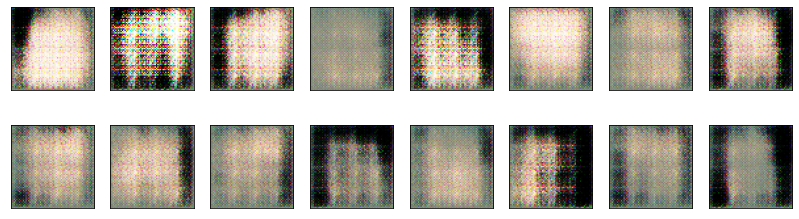

2025-11-14 21:31:07 | Epoch [2/50] | Batch 0/509 | d_loss: -11.7221 | g_loss: 367.8650
2025-11-14 21:31:14 | Epoch [2/50] | Batch 50/509 | d_loss: -3.7790 | g_loss: 360.4259
2025-11-14 21:31:22 | Epoch [2/50] | Batch 100/509 | d_loss: -53.2899 | g_loss: 351.5740
2025-11-14 21:31:29 | Epoch [2/50] | Batch 150/509 | d_loss: -983.3732 | g_loss: 448.6591
2025-11-14 21:31:37 | Epoch [2/50] | Batch 200/509 | d_loss: -1314.3298 | g_loss: 639.2078
2025-11-14 21:31:45 | Epoch [2/50] | Batch 250/509 | d_loss: -1521.5044 | g_loss: 744.7373
2025-11-14 21:31:53 | Epoch [2/50] | Batch 300/509 | d_loss: -1404.2495 | g_loss: 695.1668
2025-11-14 21:32:01 | Epoch [2/50] | Batch 350/509 | d_loss: -1928.2603 | g_loss: 941.2169
2025-11-14 21:32:09 | Epoch [2/50] | Batch 400/509 | d_loss: -2152.9946 | g_loss: 1054.0254
2025-11-14 21:32:17 | Epoch [2/50] | Batch 450/509 | d_loss: -2378.3069 | g_loss: 1167.1436
2025-11-14 21:32:24 | Epoch [2/50] | Batch 500/509 | d_loss: -2615.6396 | g_loss: 1284.7766


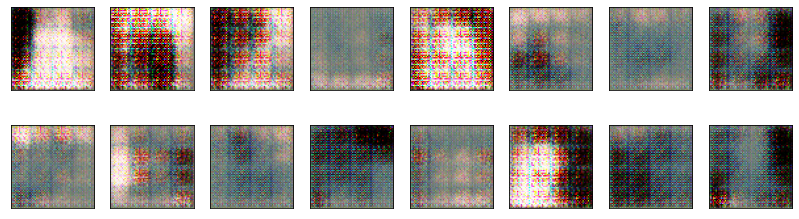

2025-11-14 21:32:27 | Epoch [3/50] | Batch 0/509 | d_loss: -2652.8774 | g_loss: 1306.0001
2025-11-14 21:32:35 | Epoch [3/50] | Batch 50/509 | d_loss: -893.9835 | g_loss: 834.4691
2025-11-14 21:32:43 | Epoch [3/50] | Batch 100/509 | d_loss: -3022.3320 | g_loss: 1473.1702
2025-11-14 21:32:50 | Epoch [3/50] | Batch 150/509 | d_loss: -3285.5244 | g_loss: 1610.9473
2025-11-14 21:32:58 | Epoch [3/50] | Batch 200/509 | d_loss: -3535.4995 | g_loss: 1736.4207
2025-11-14 21:33:06 | Epoch [3/50] | Batch 250/509 | d_loss: -3786.7783 | g_loss: 1863.4944
2025-11-14 21:33:14 | Epoch [3/50] | Batch 300/509 | d_loss: -4047.9583 | g_loss: 1992.6758
2025-11-14 21:33:22 | Epoch [3/50] | Batch 350/509 | d_loss: -4301.9595 | g_loss: 2122.4146
2025-11-14 21:33:29 | Epoch [3/50] | Batch 400/509 | d_loss: -4572.3926 | g_loss: 2256.2483
2025-11-14 21:33:37 | Epoch [3/50] | Batch 450/509 | d_loss: -4842.8740 | g_loss: 2394.3142
2025-11-14 21:33:45 | Epoch [3/50] | Batch 500/509 | d_loss: -5121.5444 | g_loss: 253

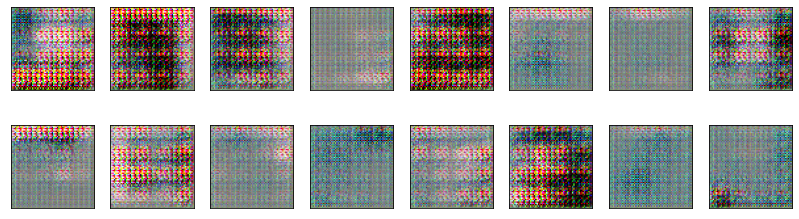

2025-11-14 21:33:48 | Epoch [4/50] | Batch 0/509 | d_loss: -5174.2676 | g_loss: 2558.6311
2025-11-14 21:33:55 | Epoch [4/50] | Batch 50/509 | d_loss: -5452.6616 | g_loss: 2700.9463
2025-11-14 21:34:03 | Epoch [4/50] | Batch 100/509 | d_loss: -2006.1338 | g_loss: 1467.1119
2025-11-14 21:34:11 | Epoch [4/50] | Batch 150/509 | d_loss: -4989.6401 | g_loss: 2241.7102
2025-11-14 21:34:19 | Epoch [4/50] | Batch 200/509 | d_loss: -5644.5581 | g_loss: 2711.0239
2025-11-14 21:34:26 | Epoch [4/50] | Batch 250/509 | d_loss: -5950.7466 | g_loss: 2899.7139
2025-11-14 21:34:34 | Epoch [4/50] | Batch 300/509 | d_loss: -6192.8286 | g_loss: 3024.7107
2025-11-14 21:34:42 | Epoch [4/50] | Batch 350/509 | d_loss: -6399.4048 | g_loss: 3127.5063
2025-11-14 21:34:50 | Epoch [4/50] | Batch 400/509 | d_loss: -6587.3994 | g_loss: 3225.0076
2025-11-14 21:34:58 | Epoch [4/50] | Batch 450/509 | d_loss: -6799.9307 | g_loss: 3321.3345
2025-11-14 21:35:05 | Epoch [4/50] | Batch 500/509 | d_loss: -7027.1060 | g_loss: 3

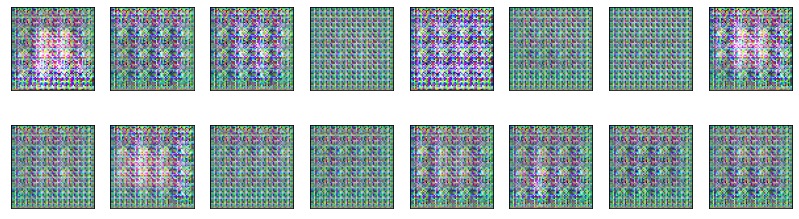

2025-11-14 21:35:08 | Epoch [5/50] | Batch 0/509 | d_loss: -7060.1431 | g_loss: 3443.8479
2025-11-14 21:35:16 | Epoch [5/50] | Batch 50/509 | d_loss: -7279.6724 | g_loss: 3548.9290
2025-11-14 21:35:23 | Epoch [5/50] | Batch 100/509 | d_loss: -7350.8628 | g_loss: 3653.9087
2025-11-14 21:35:31 | Epoch [5/50] | Batch 150/509 | d_loss: -7736.4956 | g_loss: 3767.7202
2025-11-14 21:35:39 | Epoch [5/50] | Batch 200/509 | d_loss: -7971.2129 | g_loss: 3879.9160
2025-11-14 21:35:47 | Epoch [5/50] | Batch 250/509 | d_loss: -8204.6865 | g_loss: 3993.5571
2025-11-14 21:35:55 | Epoch [5/50] | Batch 300/509 | d_loss: 321.0071 | g_loss: 3625.1899
2025-11-14 21:36:03 | Epoch [5/50] | Batch 350/509 | d_loss: -188.6033 | g_loss: 3664.1055
2025-11-14 21:36:11 | Epoch [5/50] | Batch 400/509 | d_loss: -8415.1318 | g_loss: 4099.4727
2025-11-14 21:36:18 | Epoch [5/50] | Batch 450/509 | d_loss: -8736.4053 | g_loss: 4241.6045
2025-11-14 21:36:26 | Epoch [5/50] | Batch 500/509 | d_loss: -8997.4043 | g_loss: 4368

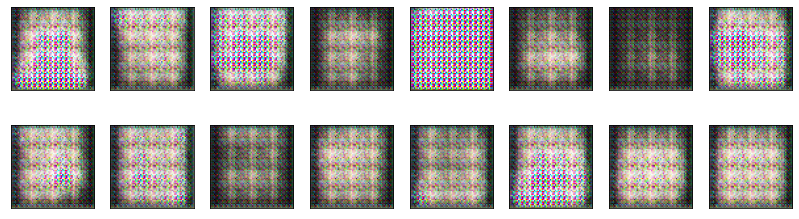

2025-11-14 21:36:29 | Epoch [6/50] | Batch 0/509 | d_loss: -9056.5283 | g_loss: 4390.7305
2025-11-14 21:36:36 | Epoch [6/50] | Batch 50/509 | d_loss: -9320.2256 | g_loss: 4518.5381
2025-11-14 21:36:44 | Epoch [6/50] | Batch 100/509 | d_loss: -9592.2207 | g_loss: 4646.8877
2025-11-14 21:36:52 | Epoch [6/50] | Batch 150/509 | d_loss: -9861.1309 | g_loss: 4777.5049
2025-11-14 21:37:00 | Epoch [6/50] | Batch 200/509 | d_loss: -10137.2090 | g_loss: 4909.4038
2025-11-14 21:37:07 | Epoch [6/50] | Batch 250/509 | d_loss: -10415.6982 | g_loss: 5040.8154
2025-11-14 21:37:15 | Epoch [6/50] | Batch 300/509 | d_loss: -10696.4502 | g_loss: 5177.7783
2025-11-14 21:37:23 | Epoch [6/50] | Batch 350/509 | d_loss: -10695.3252 | g_loss: 5246.6172
2025-11-14 21:37:31 | Epoch [6/50] | Batch 400/509 | d_loss: -11195.5361 | g_loss: 5420.5674
2025-11-14 21:37:39 | Epoch [6/50] | Batch 450/509 | d_loss: -11492.9932 | g_loss: 5568.9849
2025-11-14 21:37:46 | Epoch [6/50] | Batch 500/509 | d_loss: -11811.4219 | g_

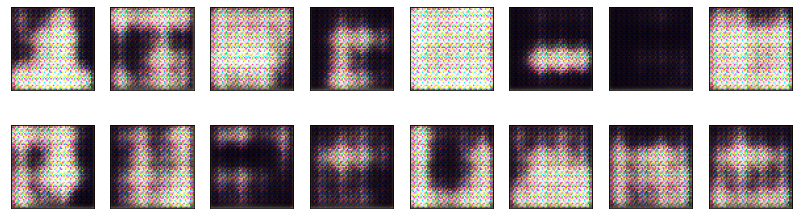

2025-11-14 21:37:50 | Epoch [7/50] | Batch 0/509 | d_loss: -11881.7549 | g_loss: 5746.8867
2025-11-14 21:37:57 | Epoch [7/50] | Batch 50/509 | d_loss: -12190.5098 | g_loss: 5899.9067
2025-11-14 21:38:05 | Epoch [7/50] | Batch 100/509 | d_loss: -12510.0664 | g_loss: 6055.3555
2025-11-14 21:38:13 | Epoch [7/50] | Batch 150/509 | d_loss: -12841.5391 | g_loss: 6212.8872
2025-11-14 21:38:21 | Epoch [7/50] | Batch 200/509 | d_loss: -13170.2461 | g_loss: 6374.4277
2025-11-14 21:38:28 | Epoch [7/50] | Batch 250/509 | d_loss: -13501.9443 | g_loss: 6537.8032
2025-11-14 21:38:36 | Epoch [7/50] | Batch 300/509 | d_loss: -13841.3105 | g_loss: 6702.6826
2025-11-14 21:38:44 | Epoch [7/50] | Batch 350/509 | d_loss: -14138.7051 | g_loss: 6860.0078
2025-11-14 21:38:52 | Epoch [7/50] | Batch 400/509 | d_loss: 63.2677 | g_loss: 5969.3467
2025-11-14 21:39:00 | Epoch [7/50] | Batch 450/509 | d_loss: 40.6207 | g_loss: 6023.1328
2025-11-14 21:39:07 | Epoch [7/50] | Batch 500/509 | d_loss: 15.8065 | g_loss: 60

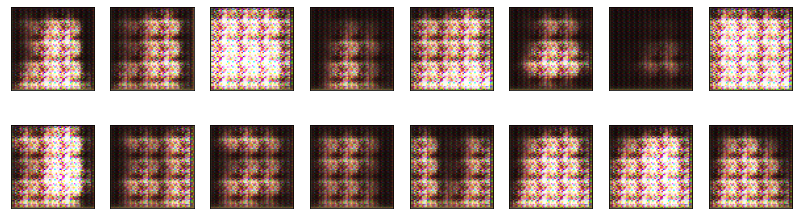

2025-11-14 21:39:10 | Epoch [8/50] | Batch 0/509 | d_loss: 20.3407 | g_loss: 6047.4795
2025-11-14 21:39:18 | Epoch [8/50] | Batch 50/509 | d_loss: 5.7899 | g_loss: 6066.1455
2025-11-14 21:39:26 | Epoch [8/50] | Batch 100/509 | d_loss: 19.4318 | g_loss: 6079.8223
2025-11-14 21:39:34 | Epoch [8/50] | Batch 150/509 | d_loss: 5.7835 | g_loss: 6088.8413
2025-11-14 21:39:41 | Epoch [8/50] | Batch 200/509 | d_loss: -8.2690 | g_loss: 6094.6582
2025-11-14 21:39:49 | Epoch [8/50] | Batch 250/509 | d_loss: -17.8450 | g_loss: 6096.0303
2025-11-14 21:39:57 | Epoch [8/50] | Batch 300/509 | d_loss: -10.8532 | g_loss: 6094.7261
2025-11-14 21:40:05 | Epoch [8/50] | Batch 350/509 | d_loss: -8.4379 | g_loss: 6093.9629
2025-11-14 21:40:13 | Epoch [8/50] | Batch 400/509 | d_loss: -9.8895 | g_loss: 6097.3740
2025-11-14 21:40:21 | Epoch [8/50] | Batch 450/509 | d_loss: -9.5615 | g_loss: 6101.7051
2025-11-14 21:40:28 | Epoch [8/50] | Batch 500/509 | d_loss: -11.6355 | g_loss: 6106.2690


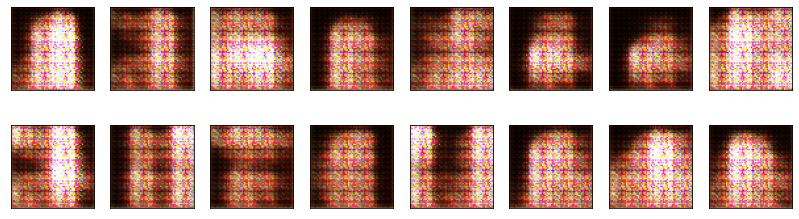

2025-11-14 21:40:31 | Epoch [9/50] | Batch 0/509 | d_loss: 0.0042 | g_loss: 6105.7168
2025-11-14 21:40:39 | Epoch [9/50] | Batch 50/509 | d_loss: -4.4049 | g_loss: 6112.2109
2025-11-14 21:40:47 | Epoch [9/50] | Batch 100/509 | d_loss: -13.1988 | g_loss: 6110.5898
2025-11-14 21:40:54 | Epoch [9/50] | Batch 150/509 | d_loss: -5.9599 | g_loss: 6106.7188
2025-11-14 21:41:02 | Epoch [9/50] | Batch 200/509 | d_loss: -12.9192 | g_loss: 6106.0713
2025-11-14 21:41:10 | Epoch [9/50] | Batch 250/509 | d_loss: -13.0013 | g_loss: 6107.0854
2025-11-14 21:41:18 | Epoch [9/50] | Batch 300/509 | d_loss: -13.8689 | g_loss: 6108.5947
2025-11-14 21:41:26 | Epoch [9/50] | Batch 350/509 | d_loss: -10.8483 | g_loss: 6100.7422
2025-11-14 21:41:34 | Epoch [9/50] | Batch 400/509 | d_loss: -5.8228 | g_loss: 6098.4727
2025-11-14 21:41:41 | Epoch [9/50] | Batch 450/509 | d_loss: -9.7343 | g_loss: 6107.6357
2025-11-14 21:41:49 | Epoch [9/50] | Batch 500/509 | d_loss: -11.3710 | g_loss: 6098.3081


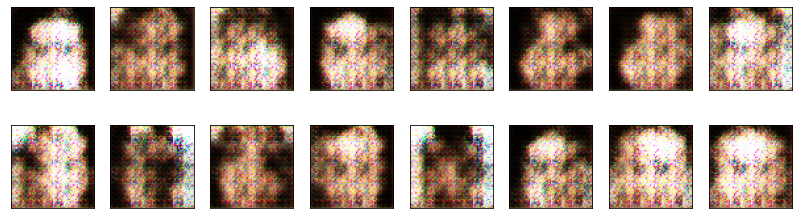

2025-11-14 21:41:52 | Epoch [10/50] | Batch 0/509 | d_loss: -9.7322 | g_loss: 6096.2754
2025-11-14 21:42:00 | Epoch [10/50] | Batch 50/509 | d_loss: -5.5624 | g_loss: 6098.2568
2025-11-14 21:42:07 | Epoch [10/50] | Batch 100/509 | d_loss: -2.1396 | g_loss: 6100.1875
2025-11-14 21:42:15 | Epoch [10/50] | Batch 150/509 | d_loss: -4.2839 | g_loss: 6113.7373
2025-11-14 21:42:23 | Epoch [10/50] | Batch 200/509 | d_loss: -2.2079 | g_loss: 6111.6016
2025-11-14 21:42:31 | Epoch [10/50] | Batch 250/509 | d_loss: -7.3342 | g_loss: 6110.3667
2025-11-14 21:42:39 | Epoch [10/50] | Batch 300/509 | d_loss: -8.8252 | g_loss: 6114.3301
2025-11-14 21:42:47 | Epoch [10/50] | Batch 350/509 | d_loss: -5.1441 | g_loss: 6106.9258
2025-11-14 21:42:54 | Epoch [10/50] | Batch 400/509 | d_loss: -7.8622 | g_loss: 6113.2378
2025-11-14 21:43:02 | Epoch [10/50] | Batch 450/509 | d_loss: -7.7297 | g_loss: 6108.2832
2025-11-14 21:43:10 | Epoch [10/50] | Batch 500/509 | d_loss: -23.6197 | g_loss: 6133.2168


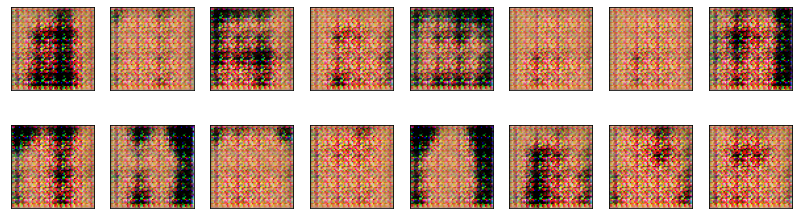

2025-11-14 21:43:13 | Epoch [11/50] | Batch 0/509 | d_loss: -26.4964 | g_loss: 6123.9717
2025-11-14 21:43:21 | Epoch [11/50] | Batch 50/509 | d_loss: -46.4068 | g_loss: 6108.1348
2025-11-14 21:43:28 | Epoch [11/50] | Batch 100/509 | d_loss: -71.9350 | g_loss: 6086.2739
2025-11-14 21:43:36 | Epoch [11/50] | Batch 150/509 | d_loss: -13.1033 | g_loss: 6087.9980
2025-11-14 21:43:44 | Epoch [11/50] | Batch 200/509 | d_loss: -7.0570 | g_loss: 6096.6885
2025-11-14 21:43:52 | Epoch [11/50] | Batch 250/509 | d_loss: -5.4658 | g_loss: 6101.5698
2025-11-14 21:44:00 | Epoch [11/50] | Batch 300/509 | d_loss: -9.1935 | g_loss: 6101.0522
2025-11-14 21:44:08 | Epoch [11/50] | Batch 350/509 | d_loss: -8.4082 | g_loss: 6104.8027
2025-11-14 21:44:15 | Epoch [11/50] | Batch 400/509 | d_loss: -6.5932 | g_loss: 6106.5977
2025-11-14 21:44:23 | Epoch [11/50] | Batch 450/509 | d_loss: -6.7074 | g_loss: 6106.9736
2025-11-14 21:44:31 | Epoch [11/50] | Batch 500/509 | d_loss: -7.2313 | g_loss: 6102.0576


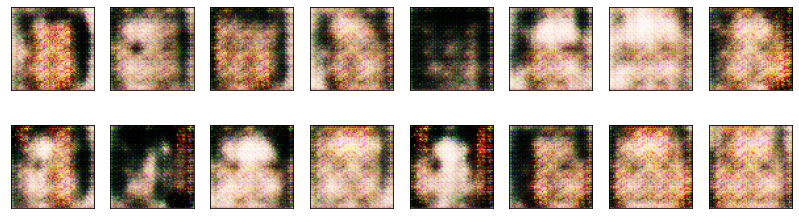

2025-11-14 21:44:34 | Epoch [12/50] | Batch 0/509 | d_loss: -6.3661 | g_loss: 6103.0723
2025-11-14 21:44:41 | Epoch [12/50] | Batch 50/509 | d_loss: -4.4287 | g_loss: 6103.2744
2025-11-14 21:44:49 | Epoch [12/50] | Batch 100/509 | d_loss: -6.0766 | g_loss: 6104.3535
2025-11-14 21:44:57 | Epoch [12/50] | Batch 150/509 | d_loss: -5.2212 | g_loss: 6098.7964
2025-11-14 21:45:05 | Epoch [12/50] | Batch 200/509 | d_loss: -5.2689 | g_loss: 6099.5093
2025-11-14 21:45:12 | Epoch [12/50] | Batch 250/509 | d_loss: -4.4376 | g_loss: 6101.7095
2025-11-14 21:45:20 | Epoch [12/50] | Batch 300/509 | d_loss: -4.0389 | g_loss: 6098.6523
2025-11-14 21:45:28 | Epoch [12/50] | Batch 350/509 | d_loss: -5.8074 | g_loss: 6099.9619
2025-11-14 21:45:36 | Epoch [12/50] | Batch 400/509 | d_loss: -4.2745 | g_loss: 6100.8330
2025-11-14 21:45:44 | Epoch [12/50] | Batch 450/509 | d_loss: -4.3736 | g_loss: 6102.7168
2025-11-14 21:45:51 | Epoch [12/50] | Batch 500/509 | d_loss: -2.2786 | g_loss: 6103.1768


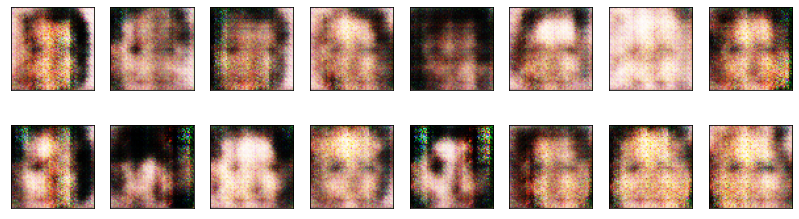

2025-11-14 21:45:54 | Epoch [13/50] | Batch 0/509 | d_loss: -5.5823 | g_loss: 6104.5337
2025-11-14 21:46:02 | Epoch [13/50] | Batch 50/509 | d_loss: -5.7362 | g_loss: 6104.1680
2025-11-14 21:46:10 | Epoch [13/50] | Batch 100/509 | d_loss: -4.1057 | g_loss: 6105.6265
2025-11-14 21:46:18 | Epoch [13/50] | Batch 150/509 | d_loss: -2.9415 | g_loss: 6103.2080
2025-11-14 21:46:26 | Epoch [13/50] | Batch 200/509 | d_loss: -5.4084 | g_loss: 6106.9873
2025-11-14 21:46:33 | Epoch [13/50] | Batch 250/509 | d_loss: -5.7004 | g_loss: 6106.4219
2025-11-14 21:46:41 | Epoch [13/50] | Batch 300/509 | d_loss: -6.8365 | g_loss: 6109.7339
2025-11-14 21:46:49 | Epoch [13/50] | Batch 350/509 | d_loss: -6.3455 | g_loss: 6111.1699
2025-11-14 21:46:57 | Epoch [13/50] | Batch 400/509 | d_loss: -2.9564 | g_loss: 6106.3291
2025-11-14 21:47:05 | Epoch [13/50] | Batch 450/509 | d_loss: -4.7460 | g_loss: 6098.4199
2025-11-14 21:47:12 | Epoch [13/50] | Batch 500/509 | d_loss: -4.1187 | g_loss: 6101.8989


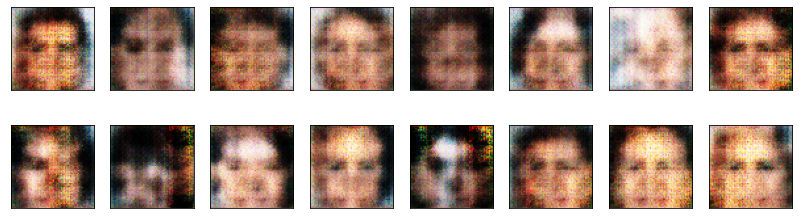

2025-11-14 21:47:15 | Epoch [14/50] | Batch 0/509 | d_loss: -3.7496 | g_loss: 6100.4102
2025-11-14 21:47:23 | Epoch [14/50] | Batch 50/509 | d_loss: -2.3816 | g_loss: 6106.9609
2025-11-14 21:47:31 | Epoch [14/50] | Batch 100/509 | d_loss: -3.5106 | g_loss: 6101.6260
2025-11-14 21:47:38 | Epoch [14/50] | Batch 150/509 | d_loss: -5.7092 | g_loss: 6107.6143
2025-11-14 21:47:46 | Epoch [14/50] | Batch 200/509 | d_loss: -3.3528 | g_loss: 6103.2983
2025-11-14 21:47:54 | Epoch [14/50] | Batch 250/509 | d_loss: -3.8990 | g_loss: 6110.4053
2025-11-14 21:48:02 | Epoch [14/50] | Batch 300/509 | d_loss: -5.3788 | g_loss: 6099.5977
2025-11-14 21:48:10 | Epoch [14/50] | Batch 350/509 | d_loss: -5.7867 | g_loss: 6102.3555
2025-11-14 21:48:18 | Epoch [14/50] | Batch 400/509 | d_loss: -4.1692 | g_loss: 6112.8462
2025-11-14 21:48:25 | Epoch [14/50] | Batch 450/509 | d_loss: -3.4132 | g_loss: 6101.9360
2025-11-14 21:48:33 | Epoch [14/50] | Batch 500/509 | d_loss: -4.3744 | g_loss: 6108.0996


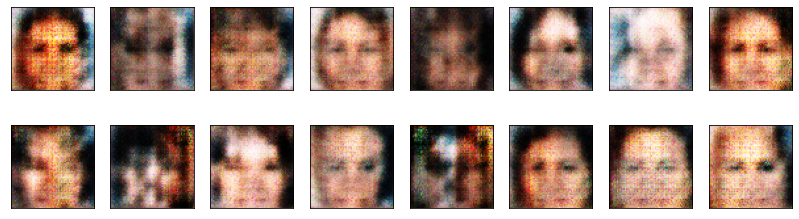

2025-11-14 21:48:36 | Epoch [15/50] | Batch 0/509 | d_loss: -1.8110 | g_loss: 6101.9697
2025-11-14 21:48:44 | Epoch [15/50] | Batch 50/509 | d_loss: -4.2846 | g_loss: 6108.3770
2025-11-14 21:48:52 | Epoch [15/50] | Batch 100/509 | d_loss: -4.4758 | g_loss: 6098.4707
2025-11-14 21:48:59 | Epoch [15/50] | Batch 150/509 | d_loss: -4.9059 | g_loss: 6107.3359
2025-11-14 21:49:07 | Epoch [15/50] | Batch 200/509 | d_loss: -5.3475 | g_loss: 6107.7344
2025-11-14 21:49:15 | Epoch [15/50] | Batch 250/509 | d_loss: -3.7104 | g_loss: 6101.4092
2025-11-14 21:49:23 | Epoch [15/50] | Batch 300/509 | d_loss: -1.9195 | g_loss: 6108.5742
2025-11-14 21:49:30 | Epoch [15/50] | Batch 350/509 | d_loss: -3.7663 | g_loss: 6110.1484
2025-11-14 21:49:38 | Epoch [15/50] | Batch 400/509 | d_loss: -5.0420 | g_loss: 6110.2856
2025-11-14 21:49:46 | Epoch [15/50] | Batch 450/509 | d_loss: -4.1323 | g_loss: 6103.0928
2025-11-14 21:49:54 | Epoch [15/50] | Batch 500/509 | d_loss: -5.5894 | g_loss: 6105.6899


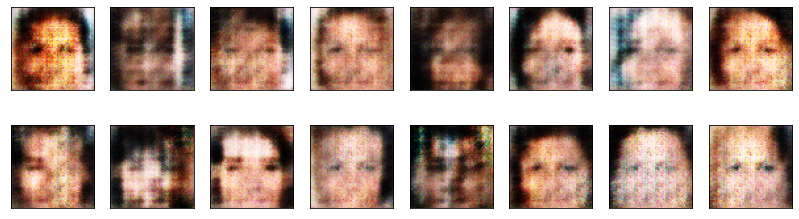

2025-11-14 21:49:57 | Epoch [16/50] | Batch 0/509 | d_loss: -2.6021 | g_loss: 6108.8013
2025-11-14 21:50:04 | Epoch [16/50] | Batch 50/509 | d_loss: -6.1340 | g_loss: 6106.3896
2025-11-14 21:50:12 | Epoch [16/50] | Batch 100/509 | d_loss: -5.0738 | g_loss: 6112.4385
2025-11-14 21:50:20 | Epoch [16/50] | Batch 150/509 | d_loss: -3.1711 | g_loss: 6106.5762
2025-11-14 21:50:28 | Epoch [16/50] | Batch 200/509 | d_loss: -4.2834 | g_loss: 6113.2803
2025-11-14 21:50:36 | Epoch [16/50] | Batch 250/509 | d_loss: -5.1303 | g_loss: 6115.2324
2025-11-14 21:50:44 | Epoch [16/50] | Batch 300/509 | d_loss: -3.9307 | g_loss: 6110.4658
2025-11-14 21:50:52 | Epoch [16/50] | Batch 350/509 | d_loss: -3.2023 | g_loss: 6110.5557
2025-11-14 21:50:59 | Epoch [16/50] | Batch 400/509 | d_loss: -3.8288 | g_loss: 6109.8740
2025-11-14 21:51:07 | Epoch [16/50] | Batch 450/509 | d_loss: -4.7010 | g_loss: 6107.9399
2025-11-14 21:51:15 | Epoch [16/50] | Batch 500/509 | d_loss: -3.4405 | g_loss: 6112.4199


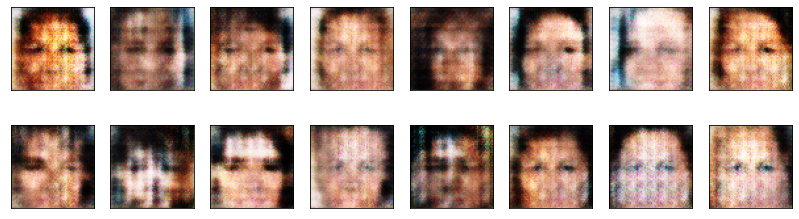

2025-11-14 21:51:17 | Epoch [17/50] | Batch 0/509 | d_loss: -4.3375 | g_loss: 6112.5308
2025-11-14 21:51:25 | Epoch [17/50] | Batch 50/509 | d_loss: -4.2597 | g_loss: 6111.2861
2025-11-14 21:51:33 | Epoch [17/50] | Batch 100/509 | d_loss: -5.0474 | g_loss: 6112.9043
2025-11-14 21:51:41 | Epoch [17/50] | Batch 150/509 | d_loss: -3.2643 | g_loss: 6105.6484
2025-11-14 21:51:49 | Epoch [17/50] | Batch 200/509 | d_loss: -4.6343 | g_loss: 6108.9229
2025-11-14 21:51:56 | Epoch [17/50] | Batch 250/509 | d_loss: -2.4242 | g_loss: 6111.3115
2025-11-14 21:52:04 | Epoch [17/50] | Batch 300/509 | d_loss: -6.5548 | g_loss: 6113.0488
2025-11-14 21:52:12 | Epoch [17/50] | Batch 350/509 | d_loss: -5.2561 | g_loss: 6103.6006
2025-11-14 21:52:20 | Epoch [17/50] | Batch 400/509 | d_loss: -4.6833 | g_loss: 6109.6304
2025-11-14 21:52:28 | Epoch [17/50] | Batch 450/509 | d_loss: -3.9772 | g_loss: 6110.3794
2025-11-14 21:52:35 | Epoch [17/50] | Batch 500/509 | d_loss: -5.3091 | g_loss: 6111.0244


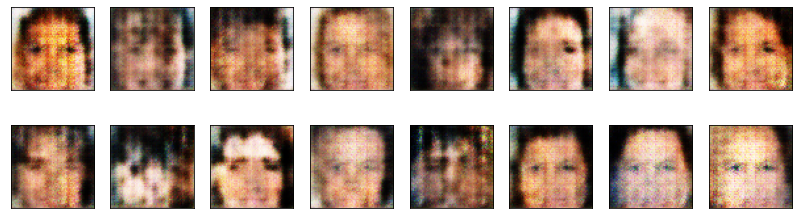

2025-11-14 21:52:38 | Epoch [18/50] | Batch 0/509 | d_loss: -4.0722 | g_loss: 6109.1084
2025-11-14 21:52:46 | Epoch [18/50] | Batch 50/509 | d_loss: -5.5482 | g_loss: 6113.5146
2025-11-14 21:52:54 | Epoch [18/50] | Batch 100/509 | d_loss: -5.8232 | g_loss: 6117.1914
2025-11-14 21:53:01 | Epoch [18/50] | Batch 150/509 | d_loss: -5.3488 | g_loss: 6109.1387
2025-11-14 21:53:09 | Epoch [18/50] | Batch 200/509 | d_loss: -4.5134 | g_loss: 6106.2900
2025-11-14 21:53:17 | Epoch [18/50] | Batch 250/509 | d_loss: -6.9263 | g_loss: 6113.1729
2025-11-14 21:53:25 | Epoch [18/50] | Batch 300/509 | d_loss: -0.6128 | g_loss: 6105.5352
2025-11-14 21:53:33 | Epoch [18/50] | Batch 350/509 | d_loss: -5.8158 | g_loss: 6114.8481
2025-11-14 21:53:41 | Epoch [18/50] | Batch 400/509 | d_loss: -2.6681 | g_loss: 6115.0801
2025-11-14 21:53:49 | Epoch [18/50] | Batch 450/509 | d_loss: -5.5932 | g_loss: 6114.2441
2025-11-14 21:53:56 | Epoch [18/50] | Batch 500/509 | d_loss: -4.8733 | g_loss: 6117.9170


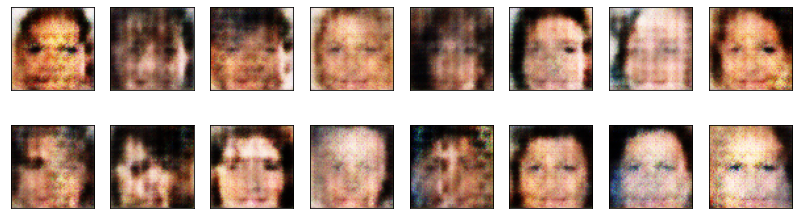

2025-11-14 21:53:59 | Epoch [19/50] | Batch 0/509 | d_loss: -3.1319 | g_loss: 6117.9043
2025-11-14 21:54:07 | Epoch [19/50] | Batch 50/509 | d_loss: -5.1318 | g_loss: 6125.3887
2025-11-14 21:54:14 | Epoch [19/50] | Batch 100/509 | d_loss: -5.8239 | g_loss: 6114.8740
2025-11-14 21:54:22 | Epoch [19/50] | Batch 150/509 | d_loss: -6.8578 | g_loss: 6119.7700
2025-11-14 21:54:30 | Epoch [19/50] | Batch 200/509 | d_loss: -6.2159 | g_loss: 6116.9473
2025-11-14 21:54:38 | Epoch [19/50] | Batch 250/509 | d_loss: -5.3079 | g_loss: 6121.6768
2025-11-14 21:54:46 | Epoch [19/50] | Batch 300/509 | d_loss: -6.4069 | g_loss: 6113.6143
2025-11-14 21:54:54 | Epoch [19/50] | Batch 350/509 | d_loss: -4.0361 | g_loss: 6119.7085
2025-11-14 21:55:01 | Epoch [19/50] | Batch 400/509 | d_loss: -5.5893 | g_loss: 6109.0830
2025-11-14 21:55:09 | Epoch [19/50] | Batch 450/509 | d_loss: -1.2273 | g_loss: 6120.1270
2025-11-14 21:55:17 | Epoch [19/50] | Batch 500/509 | d_loss: -4.5321 | g_loss: 6110.0518


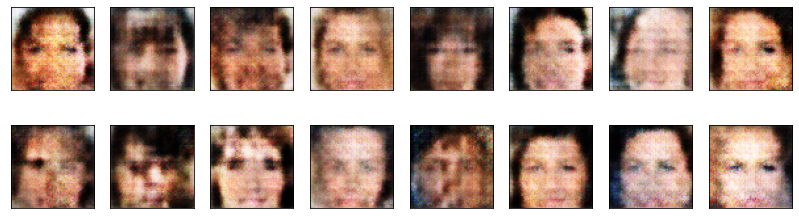

2025-11-14 21:55:20 | Epoch [20/50] | Batch 0/509 | d_loss: -4.2354 | g_loss: 6112.7041
2025-11-14 21:55:28 | Epoch [20/50] | Batch 50/509 | d_loss: -4.4703 | g_loss: 6111.3735
2025-11-14 21:55:35 | Epoch [20/50] | Batch 100/509 | d_loss: -6.0787 | g_loss: 6105.9150
2025-11-14 21:55:43 | Epoch [20/50] | Batch 150/509 | d_loss: -3.8094 | g_loss: 6118.2100
2025-11-14 21:55:51 | Epoch [20/50] | Batch 200/509 | d_loss: -6.5481 | g_loss: 6113.2095
2025-11-14 21:55:59 | Epoch [20/50] | Batch 250/509 | d_loss: -6.8751 | g_loss: 6116.0566
2025-11-14 21:56:07 | Epoch [20/50] | Batch 300/509 | d_loss: -5.1230 | g_loss: 6116.6299
2025-11-14 21:56:15 | Epoch [20/50] | Batch 350/509 | d_loss: -5.4847 | g_loss: 6117.4873
2025-11-14 21:56:22 | Epoch [20/50] | Batch 400/509 | d_loss: -3.4754 | g_loss: 6113.2695
2025-11-14 21:56:30 | Epoch [20/50] | Batch 450/509 | d_loss: -5.9897 | g_loss: 6116.3242
2025-11-14 21:56:38 | Epoch [20/50] | Batch 500/509 | d_loss: -4.1938 | g_loss: 6122.7817


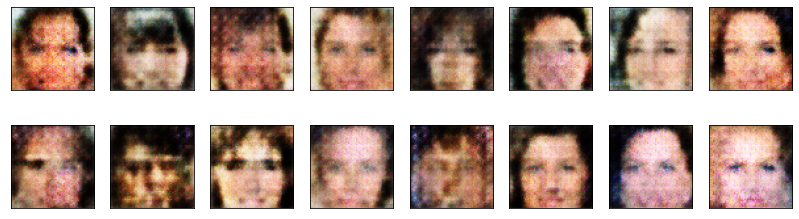

2025-11-14 21:56:41 | Epoch [21/50] | Batch 0/509 | d_loss: -5.0370 | g_loss: 6119.7007
2025-11-14 21:56:49 | Epoch [21/50] | Batch 50/509 | d_loss: -6.7280 | g_loss: 6129.4883
2025-11-14 21:56:56 | Epoch [21/50] | Batch 100/509 | d_loss: -5.0674 | g_loss: 6117.9868
2025-11-14 21:57:04 | Epoch [21/50] | Batch 150/509 | d_loss: -6.2223 | g_loss: 6110.9478
2025-11-14 21:57:12 | Epoch [21/50] | Batch 200/509 | d_loss: -6.1512 | g_loss: 6115.6572
2025-11-14 21:57:20 | Epoch [21/50] | Batch 250/509 | d_loss: -4.6703 | g_loss: 6124.2808
2025-11-14 21:57:28 | Epoch [21/50] | Batch 300/509 | d_loss: -6.9429 | g_loss: 6124.4551
2025-11-14 21:57:36 | Epoch [21/50] | Batch 350/509 | d_loss: -3.8278 | g_loss: 6116.7246
2025-11-14 21:57:43 | Epoch [21/50] | Batch 400/509 | d_loss: -6.3033 | g_loss: 6120.3818
2025-11-14 21:57:51 | Epoch [21/50] | Batch 450/509 | d_loss: -6.7306 | g_loss: 6123.4922
2025-11-14 21:57:59 | Epoch [21/50] | Batch 500/509 | d_loss: -6.6772 | g_loss: 6125.7593


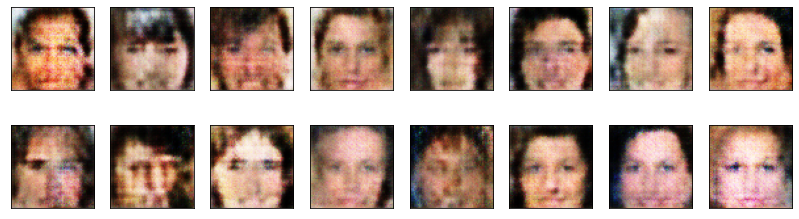

2025-11-14 21:58:02 | Epoch [22/50] | Batch 0/509 | d_loss: -6.7733 | g_loss: 6123.7749
2025-11-14 21:58:10 | Epoch [22/50] | Batch 50/509 | d_loss: -5.4056 | g_loss: 6120.5039
2025-11-14 21:58:18 | Epoch [22/50] | Batch 100/509 | d_loss: -6.1810 | g_loss: 6115.3008
2025-11-14 21:58:25 | Epoch [22/50] | Batch 150/509 | d_loss: -6.3841 | g_loss: 6118.9521
2025-11-14 21:58:33 | Epoch [22/50] | Batch 200/509 | d_loss: -4.6989 | g_loss: 6121.5151
2025-11-14 21:58:41 | Epoch [22/50] | Batch 250/509 | d_loss: -6.6457 | g_loss: 6123.4805
2025-11-14 21:58:49 | Epoch [22/50] | Batch 300/509 | d_loss: -4.6620 | g_loss: 6111.0205
2025-11-14 21:58:56 | Epoch [22/50] | Batch 350/509 | d_loss: -4.5217 | g_loss: 6114.5728
2025-11-14 21:59:04 | Epoch [22/50] | Batch 400/509 | d_loss: -6.1558 | g_loss: 6112.5840
2025-11-14 21:59:12 | Epoch [22/50] | Batch 450/509 | d_loss: -4.0046 | g_loss: 6123.2959
2025-11-14 21:59:20 | Epoch [22/50] | Batch 500/509 | d_loss: -3.2830 | g_loss: 6114.7842


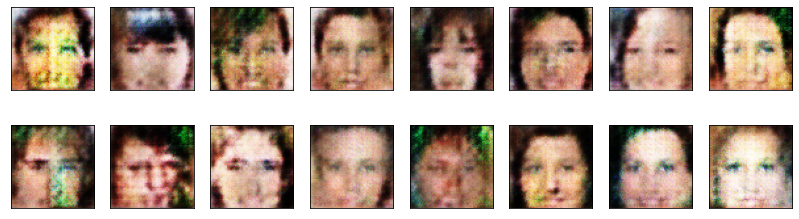

2025-11-14 21:59:23 | Epoch [23/50] | Batch 0/509 | d_loss: -4.6293 | g_loss: 6122.2305
2025-11-14 21:59:30 | Epoch [23/50] | Batch 50/509 | d_loss: -6.6101 | g_loss: 6112.3623
2025-11-14 21:59:38 | Epoch [23/50] | Batch 100/509 | d_loss: -5.6368 | g_loss: 6106.8760
2025-11-14 21:59:46 | Epoch [23/50] | Batch 150/509 | d_loss: -4.3922 | g_loss: 6114.4844
2025-11-14 21:59:54 | Epoch [23/50] | Batch 200/509 | d_loss: -6.1700 | g_loss: 6111.4160
2025-11-14 22:00:02 | Epoch [23/50] | Batch 250/509 | d_loss: -5.3240 | g_loss: 6121.9521
2025-11-14 22:00:10 | Epoch [23/50] | Batch 300/509 | d_loss: -5.4590 | g_loss: 6110.1895
2025-11-14 22:00:17 | Epoch [23/50] | Batch 350/509 | d_loss: -6.6166 | g_loss: 6114.3511
2025-11-14 22:00:25 | Epoch [23/50] | Batch 400/509 | d_loss: -6.5583 | g_loss: 6111.0532
2025-11-14 22:00:33 | Epoch [23/50] | Batch 450/509 | d_loss: -7.8950 | g_loss: 6107.1997
2025-11-14 22:00:40 | Epoch [23/50] | Batch 500/509 | d_loss: -4.9633 | g_loss: 6113.5156


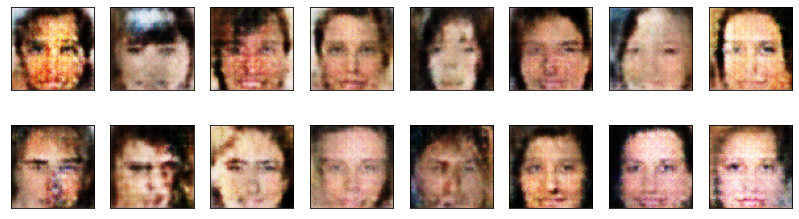

2025-11-14 22:00:43 | Epoch [24/50] | Batch 0/509 | d_loss: -5.4434 | g_loss: 6111.3823
2025-11-14 22:00:51 | Epoch [24/50] | Batch 50/509 | d_loss: -5.6272 | g_loss: 6107.7822
2025-11-14 22:00:59 | Epoch [24/50] | Batch 100/509 | d_loss: -7.3441 | g_loss: 6102.0488
2025-11-14 22:01:07 | Epoch [24/50] | Batch 150/509 | d_loss: -6.0266 | g_loss: 6108.7676
2025-11-14 22:01:15 | Epoch [24/50] | Batch 200/509 | d_loss: -5.6353 | g_loss: 6113.0010
2025-11-14 22:01:22 | Epoch [24/50] | Batch 250/509 | d_loss: -6.2915 | g_loss: 6103.4082
2025-11-14 22:01:30 | Epoch [24/50] | Batch 300/509 | d_loss: -2.7054 | g_loss: 6097.1367
2025-11-14 22:01:38 | Epoch [24/50] | Batch 350/509 | d_loss: -5.5535 | g_loss: 6097.7534
2025-11-14 22:01:46 | Epoch [24/50] | Batch 400/509 | d_loss: -7.4127 | g_loss: 6111.0732
2025-11-14 22:01:54 | Epoch [24/50] | Batch 450/509 | d_loss: -6.6174 | g_loss: 6107.5518
2025-11-14 22:02:02 | Epoch [24/50] | Batch 500/509 | d_loss: -5.6001 | g_loss: 6107.8398


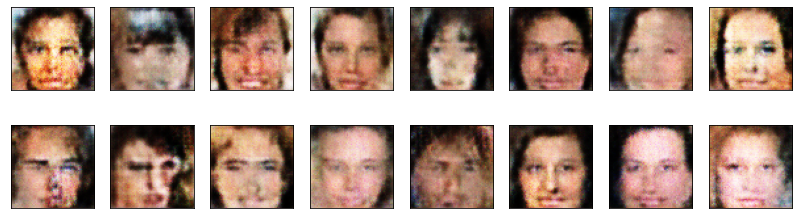

2025-11-14 22:02:05 | Epoch [25/50] | Batch 0/509 | d_loss: -5.0346 | g_loss: 6099.9600
2025-11-14 22:02:13 | Epoch [25/50] | Batch 50/509 | d_loss: -7.4740 | g_loss: 6111.4902
2025-11-14 22:02:21 | Epoch [25/50] | Batch 100/509 | d_loss: -5.1136 | g_loss: 6109.3242
2025-11-14 22:02:28 | Epoch [25/50] | Batch 150/509 | d_loss: -6.1824 | g_loss: 6107.9111
2025-11-14 22:02:36 | Epoch [25/50] | Batch 200/509 | d_loss: -4.3470 | g_loss: 6110.1045
2025-11-14 22:02:44 | Epoch [25/50] | Batch 250/509 | d_loss: -5.0912 | g_loss: 6094.3047
2025-11-14 22:02:52 | Epoch [25/50] | Batch 300/509 | d_loss: -5.6487 | g_loss: 6095.8525
2025-11-14 22:02:59 | Epoch [25/50] | Batch 350/509 | d_loss: -6.0703 | g_loss: 6101.3828
2025-11-14 22:03:07 | Epoch [25/50] | Batch 400/509 | d_loss: -2.4431 | g_loss: 6110.6074
2025-11-14 22:03:15 | Epoch [25/50] | Batch 450/509 | d_loss: -5.6147 | g_loss: 6098.4619
2025-11-14 22:03:23 | Epoch [25/50] | Batch 500/509 | d_loss: -6.1599 | g_loss: 6101.3501


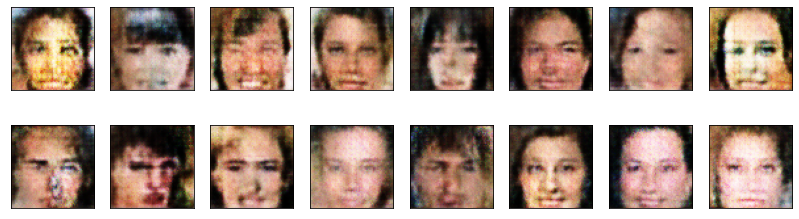

2025-11-14 22:03:26 | Epoch [26/50] | Batch 0/509 | d_loss: -4.1663 | g_loss: 6096.3936
2025-11-14 22:03:33 | Epoch [26/50] | Batch 50/509 | d_loss: -5.7344 | g_loss: 6092.2349
2025-11-14 22:03:41 | Epoch [26/50] | Batch 100/509 | d_loss: -7.7890 | g_loss: 6100.5483
2025-11-14 22:03:49 | Epoch [26/50] | Batch 150/509 | d_loss: -6.0448 | g_loss: 6096.2461
2025-11-14 22:03:57 | Epoch [26/50] | Batch 200/509 | d_loss: -6.1578 | g_loss: 6100.7012
2025-11-14 22:04:04 | Epoch [26/50] | Batch 250/509 | d_loss: -5.0731 | g_loss: 6091.1201
2025-11-14 22:04:12 | Epoch [26/50] | Batch 300/509 | d_loss: -6.1981 | g_loss: 6096.9644
2025-11-14 22:04:20 | Epoch [26/50] | Batch 350/509 | d_loss: -5.2444 | g_loss: 6093.8843
2025-11-14 22:04:28 | Epoch [26/50] | Batch 400/509 | d_loss: -8.1382 | g_loss: 6088.3394
2025-11-14 22:04:36 | Epoch [26/50] | Batch 450/509 | d_loss: -7.1486 | g_loss: 6077.7700
2025-11-14 22:04:44 | Epoch [26/50] | Batch 500/509 | d_loss: -4.9754 | g_loss: 6091.4204


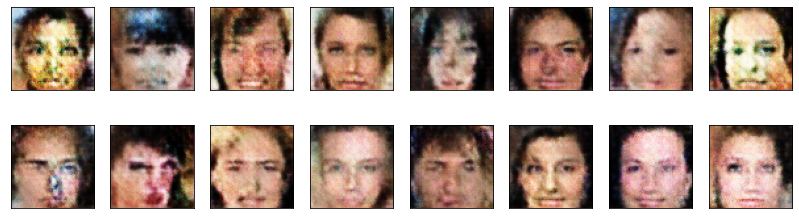

2025-11-14 22:04:47 | Epoch [27/50] | Batch 0/509 | d_loss: -7.5736 | g_loss: 6086.4019
2025-11-14 22:04:54 | Epoch [27/50] | Batch 50/509 | d_loss: -5.0951 | g_loss: 6081.7632
2025-11-14 22:05:02 | Epoch [27/50] | Batch 100/509 | d_loss: -6.3201 | g_loss: 6085.1260
2025-11-14 22:05:10 | Epoch [27/50] | Batch 150/509 | d_loss: -6.0531 | g_loss: 6078.7388
2025-11-14 22:05:18 | Epoch [27/50] | Batch 200/509 | d_loss: -7.1475 | g_loss: 6089.2080
2025-11-14 22:05:26 | Epoch [27/50] | Batch 250/509 | d_loss: -4.8833 | g_loss: 6083.6846
2025-11-14 22:05:33 | Epoch [27/50] | Batch 300/509 | d_loss: -5.4127 | g_loss: 6086.7197
2025-11-14 22:05:41 | Epoch [27/50] | Batch 350/509 | d_loss: -6.4153 | g_loss: 6077.8164
2025-11-14 22:05:49 | Epoch [27/50] | Batch 400/509 | d_loss: -3.2812 | g_loss: 6078.4385
2025-11-14 22:05:57 | Epoch [27/50] | Batch 450/509 | d_loss: -6.3198 | g_loss: 6074.3672
2025-11-14 22:06:05 | Epoch [27/50] | Batch 500/509 | d_loss: -6.2599 | g_loss: 6080.1621


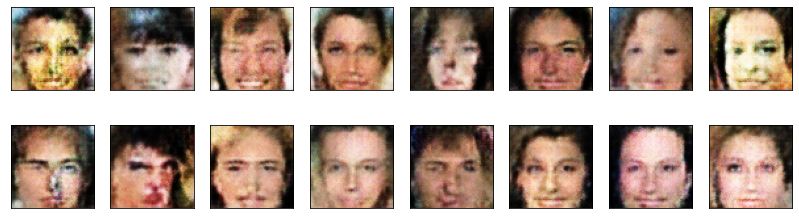

2025-11-14 22:06:08 | Epoch [28/50] | Batch 0/509 | d_loss: -5.2381 | g_loss: 6084.9990
2025-11-14 22:06:15 | Epoch [28/50] | Batch 50/509 | d_loss: -6.0681 | g_loss: 6068.1963
2025-11-14 22:06:23 | Epoch [28/50] | Batch 100/509 | d_loss: -7.0561 | g_loss: 6070.4385
2025-11-14 22:06:31 | Epoch [28/50] | Batch 150/509 | d_loss: -6.8897 | g_loss: 6071.2109
2025-11-14 22:06:38 | Epoch [28/50] | Batch 200/509 | d_loss: -5.7384 | g_loss: 6070.0415
2025-11-14 22:06:46 | Epoch [28/50] | Batch 250/509 | d_loss: -5.5910 | g_loss: 6071.4600
2025-11-14 22:06:54 | Epoch [28/50] | Batch 300/509 | d_loss: -5.9961 | g_loss: 6072.4150
2025-11-14 22:07:02 | Epoch [28/50] | Batch 350/509 | d_loss: -5.3726 | g_loss: 6077.3198
2025-11-14 22:07:10 | Epoch [28/50] | Batch 400/509 | d_loss: -4.8587 | g_loss: 6075.5356
2025-11-14 22:07:18 | Epoch [28/50] | Batch 450/509 | d_loss: -6.4585 | g_loss: 6067.2266
2025-11-14 22:07:25 | Epoch [28/50] | Batch 500/509 | d_loss: -6.5792 | g_loss: 6071.6973


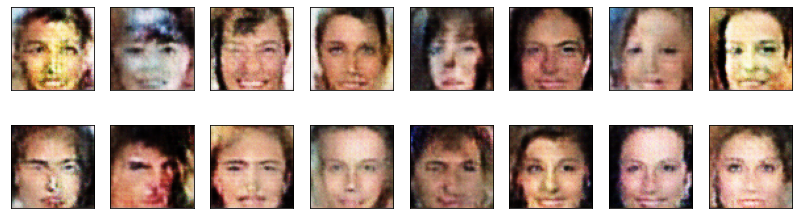

2025-11-14 22:07:28 | Epoch [29/50] | Batch 0/509 | d_loss: -3.1178 | g_loss: 6057.5020
2025-11-14 22:07:36 | Epoch [29/50] | Batch 50/509 | d_loss: -5.4196 | g_loss: 6063.2173
2025-11-14 22:07:44 | Epoch [29/50] | Batch 100/509 | d_loss: -4.8851 | g_loss: 6064.2554
2025-11-14 22:07:51 | Epoch [29/50] | Batch 150/509 | d_loss: -6.4956 | g_loss: 6065.8857
2025-11-14 22:07:59 | Epoch [29/50] | Batch 200/509 | d_loss: -4.6117 | g_loss: 6064.1143
2025-11-14 22:08:07 | Epoch [29/50] | Batch 250/509 | d_loss: -3.3602 | g_loss: 6052.6382
2025-11-14 22:08:15 | Epoch [29/50] | Batch 300/509 | d_loss: -7.1728 | g_loss: 6053.8672
2025-11-14 22:08:23 | Epoch [29/50] | Batch 350/509 | d_loss: -4.5339 | g_loss: 6060.2324
2025-11-14 22:08:30 | Epoch [29/50] | Batch 400/509 | d_loss: -6.0961 | g_loss: 6056.9565
2025-11-14 22:08:38 | Epoch [29/50] | Batch 450/509 | d_loss: -8.2275 | g_loss: 6058.3652
2025-11-14 22:08:46 | Epoch [29/50] | Batch 500/509 | d_loss: -4.7822 | g_loss: 6051.6094


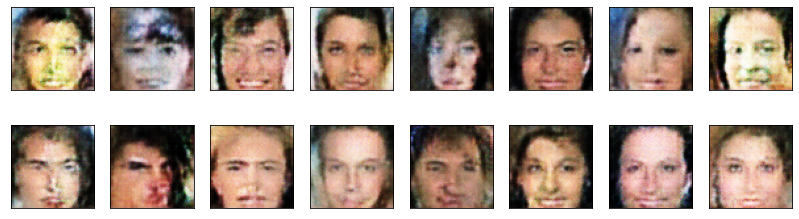

2025-11-14 22:08:49 | Epoch [30/50] | Batch 0/509 | d_loss: -6.5308 | g_loss: 6055.0488
2025-11-14 22:08:57 | Epoch [30/50] | Batch 50/509 | d_loss: -6.5400 | g_loss: 6046.6172
2025-11-14 22:09:04 | Epoch [30/50] | Batch 100/509 | d_loss: -5.3572 | g_loss: 6049.0908
2025-11-14 22:09:12 | Epoch [30/50] | Batch 150/509 | d_loss: -6.3378 | g_loss: 6047.8203
2025-11-14 22:09:20 | Epoch [30/50] | Batch 200/509 | d_loss: -5.7327 | g_loss: 6046.0903
2025-11-14 22:09:28 | Epoch [30/50] | Batch 250/509 | d_loss: -7.0160 | g_loss: 6043.5850
2025-11-14 22:09:36 | Epoch [30/50] | Batch 300/509 | d_loss: -5.1794 | g_loss: 6045.0635
2025-11-14 22:09:43 | Epoch [30/50] | Batch 350/509 | d_loss: -5.4721 | g_loss: 6045.1123
2025-11-14 22:09:51 | Epoch [30/50] | Batch 400/509 | d_loss: -5.4452 | g_loss: 6050.4199
2025-11-14 22:09:59 | Epoch [30/50] | Batch 450/509 | d_loss: -6.9578 | g_loss: 6032.4863
2025-11-14 22:10:07 | Epoch [30/50] | Batch 500/509 | d_loss: -6.1244 | g_loss: 6041.4453


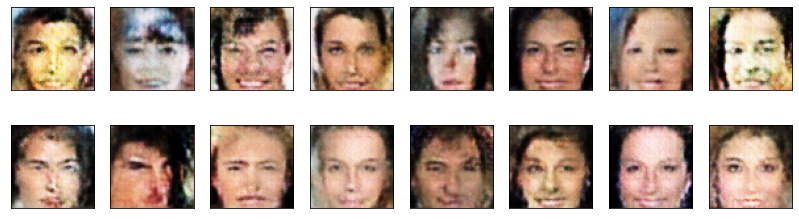

2025-11-14 22:10:10 | Epoch [31/50] | Batch 0/509 | d_loss: -5.9023 | g_loss: 6045.8325
2025-11-14 22:10:17 | Epoch [31/50] | Batch 50/509 | d_loss: -5.7875 | g_loss: 6037.4150
2025-11-14 22:10:25 | Epoch [31/50] | Batch 100/509 | d_loss: -7.1789 | g_loss: 6037.7144
2025-11-14 22:10:33 | Epoch [31/50] | Batch 150/509 | d_loss: -7.1520 | g_loss: 6033.4282
2025-11-14 22:10:41 | Epoch [31/50] | Batch 200/509 | d_loss: -5.4425 | g_loss: 6038.5977
2025-11-14 22:10:48 | Epoch [31/50] | Batch 250/509 | d_loss: -4.9335 | g_loss: 6028.7974
2025-11-14 22:10:56 | Epoch [31/50] | Batch 300/509 | d_loss: -6.4708 | g_loss: 6034.8896
2025-11-14 22:11:04 | Epoch [31/50] | Batch 350/509 | d_loss: -6.3238 | g_loss: 6024.7754
2025-11-14 22:11:12 | Epoch [31/50] | Batch 400/509 | d_loss: -8.0082 | g_loss: 6022.9790
2025-11-14 22:11:20 | Epoch [31/50] | Batch 450/509 | d_loss: -5.5786 | g_loss: 6038.5098
2025-11-14 22:11:27 | Epoch [31/50] | Batch 500/509 | d_loss: -8.3338 | g_loss: 6032.0654


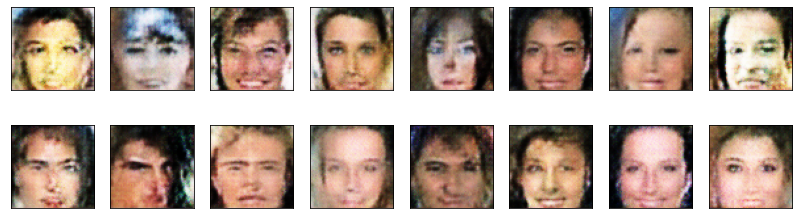

2025-11-14 22:11:30 | Epoch [32/50] | Batch 0/509 | d_loss: -4.2320 | g_loss: 6026.8896
2025-11-14 22:11:38 | Epoch [32/50] | Batch 50/509 | d_loss: -5.4923 | g_loss: 6025.9551
2025-11-14 22:11:45 | Epoch [32/50] | Batch 100/509 | d_loss: -6.1128 | g_loss: 6016.8838
2025-11-14 22:11:53 | Epoch [32/50] | Batch 150/509 | d_loss: -5.9140 | g_loss: 6022.2451
2025-11-14 22:12:01 | Epoch [32/50] | Batch 200/509 | d_loss: -5.3629 | g_loss: 6030.0996
2025-11-14 22:12:09 | Epoch [32/50] | Batch 250/509 | d_loss: -5.2572 | g_loss: 6020.7295
2025-11-14 22:12:16 | Epoch [32/50] | Batch 300/509 | d_loss: -5.1509 | g_loss: 6014.9111
2025-11-14 22:12:24 | Epoch [32/50] | Batch 350/509 | d_loss: -7.0154 | g_loss: 6012.9678
2025-11-14 22:12:32 | Epoch [32/50] | Batch 400/509 | d_loss: -6.2721 | g_loss: 6014.0112
2025-11-14 22:12:40 | Epoch [32/50] | Batch 450/509 | d_loss: -6.1822 | g_loss: 6013.7812
2025-11-14 22:12:48 | Epoch [32/50] | Batch 500/509 | d_loss: -7.2460 | g_loss: 6009.1533


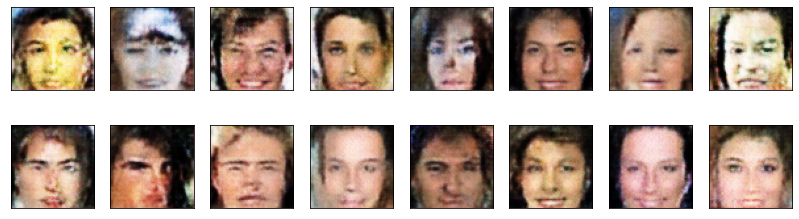

2025-11-14 22:12:51 | Epoch [33/50] | Batch 0/509 | d_loss: -4.6918 | g_loss: 6015.1562
2025-11-14 22:12:58 | Epoch [33/50] | Batch 50/509 | d_loss: -4.6081 | g_loss: 5998.9170
2025-11-14 22:13:06 | Epoch [33/50] | Batch 100/509 | d_loss: -6.7648 | g_loss: 6004.7788
2025-11-14 22:13:14 | Epoch [33/50] | Batch 150/509 | d_loss: -8.0255 | g_loss: 6006.6265
2025-11-14 22:13:22 | Epoch [33/50] | Batch 200/509 | d_loss: -7.0443 | g_loss: 6002.9731
2025-11-14 22:13:29 | Epoch [33/50] | Batch 250/509 | d_loss: -7.1172 | g_loss: 6004.6445
2025-11-14 22:13:37 | Epoch [33/50] | Batch 300/509 | d_loss: -6.0537 | g_loss: 6002.9023
2025-11-14 22:13:45 | Epoch [33/50] | Batch 350/509 | d_loss: -8.1312 | g_loss: 6003.0522
2025-11-14 22:13:53 | Epoch [33/50] | Batch 400/509 | d_loss: -7.0382 | g_loss: 5995.6753
2025-11-14 22:14:01 | Epoch [33/50] | Batch 450/509 | d_loss: -8.2146 | g_loss: 5997.0264
2025-11-14 22:14:09 | Epoch [33/50] | Batch 500/509 | d_loss: -5.2078 | g_loss: 5993.5654


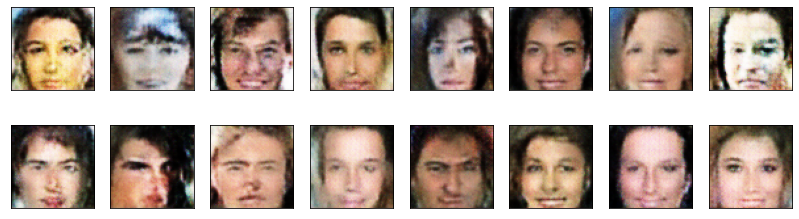

2025-11-14 22:14:11 | Epoch [34/50] | Batch 0/509 | d_loss: -3.8024 | g_loss: 5996.2500
2025-11-14 22:14:19 | Epoch [34/50] | Batch 50/509 | d_loss: -8.0122 | g_loss: 5989.9834
2025-11-14 22:14:27 | Epoch [34/50] | Batch 100/509 | d_loss: -8.4180 | g_loss: 5994.1484
2025-11-14 22:14:34 | Epoch [34/50] | Batch 150/509 | d_loss: -6.5557 | g_loss: 5990.7993
2025-11-14 22:14:42 | Epoch [34/50] | Batch 200/509 | d_loss: -7.4094 | g_loss: 5991.0674
2025-11-14 22:14:50 | Epoch [34/50] | Batch 250/509 | d_loss: -6.3586 | g_loss: 5979.9565
2025-11-14 22:14:58 | Epoch [34/50] | Batch 300/509 | d_loss: -6.6826 | g_loss: 5986.2114
2025-11-14 22:15:05 | Epoch [34/50] | Batch 350/509 | d_loss: -8.1606 | g_loss: 5975.6772
2025-11-14 22:15:13 | Epoch [34/50] | Batch 400/509 | d_loss: -6.8780 | g_loss: 5975.8994
2025-11-14 22:15:21 | Epoch [34/50] | Batch 450/509 | d_loss: -7.4170 | g_loss: 5979.6396
2025-11-14 22:15:29 | Epoch [34/50] | Batch 500/509 | d_loss: -5.7604 | g_loss: 5977.0088


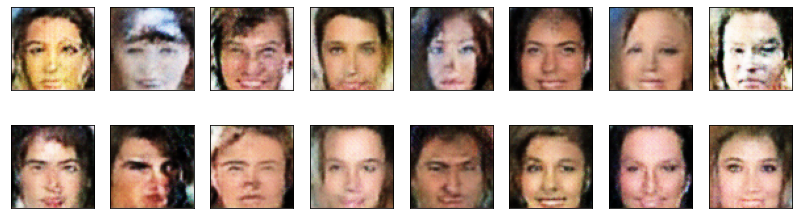

2025-11-14 22:15:32 | Epoch [35/50] | Batch 0/509 | d_loss: -8.2357 | g_loss: 5977.0986
2025-11-14 22:15:40 | Epoch [35/50] | Batch 50/509 | d_loss: -7.7529 | g_loss: 5972.8081
2025-11-14 22:15:48 | Epoch [35/50] | Batch 100/509 | d_loss: -6.8561 | g_loss: 5970.1387
2025-11-14 22:15:55 | Epoch [35/50] | Batch 150/509 | d_loss: -5.7153 | g_loss: 5968.5278
2025-11-14 22:16:03 | Epoch [35/50] | Batch 200/509 | d_loss: -7.5665 | g_loss: 5876.7891
2025-11-14 22:16:11 | Epoch [35/50] | Batch 250/509 | d_loss: -1.9283 | g_loss: 5891.3608
2025-11-14 22:16:19 | Epoch [35/50] | Batch 300/509 | d_loss: -2.7521 | g_loss: 5902.8857
2025-11-14 22:16:26 | Epoch [35/50] | Batch 350/509 | d_loss: -6.4270 | g_loss: 5909.5215
2025-11-14 22:16:34 | Epoch [35/50] | Batch 400/509 | d_loss: -4.6064 | g_loss: 5911.6577
2025-11-14 22:16:42 | Epoch [35/50] | Batch 450/509 | d_loss: -5.3024 | g_loss: 5914.8677
2025-11-14 22:16:50 | Epoch [35/50] | Batch 500/509 | d_loss: -7.8325 | g_loss: 5917.2456


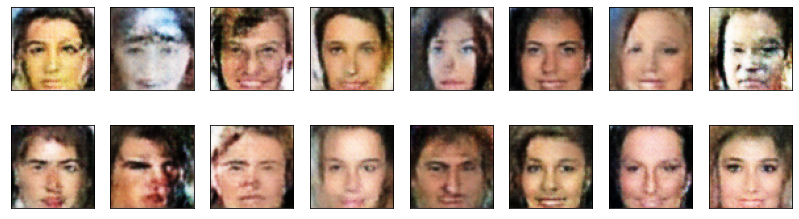

2025-11-14 22:16:53 | Epoch [36/50] | Batch 0/509 | d_loss: -4.5792 | g_loss: 5918.7559
2025-11-14 22:17:00 | Epoch [36/50] | Batch 50/509 | d_loss: -4.4703 | g_loss: 5920.4810
2025-11-14 22:17:08 | Epoch [36/50] | Batch 100/509 | d_loss: -5.1748 | g_loss: 5931.2969
2025-11-14 22:17:16 | Epoch [36/50] | Batch 150/509 | d_loss: -4.9221 | g_loss: 5926.1890
2025-11-14 22:17:24 | Epoch [36/50] | Batch 200/509 | d_loss: -5.6648 | g_loss: 5921.9717
2025-11-14 22:17:32 | Epoch [36/50] | Batch 250/509 | d_loss: -6.5064 | g_loss: 5922.9697
2025-11-14 22:17:39 | Epoch [36/50] | Batch 300/509 | d_loss: -6.5670 | g_loss: 5932.4248
2025-11-14 22:17:47 | Epoch [36/50] | Batch 350/509 | d_loss: -4.3495 | g_loss: 5931.2676
2025-11-14 22:17:55 | Epoch [36/50] | Batch 400/509 | d_loss: -6.0064 | g_loss: 5928.0332
2025-11-14 22:18:03 | Epoch [36/50] | Batch 450/509 | d_loss: -5.6079 | g_loss: 5935.0293
2025-11-14 22:18:11 | Epoch [36/50] | Batch 500/509 | d_loss: -6.3141 | g_loss: 5931.0264


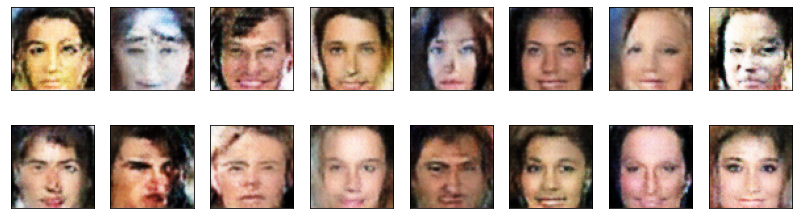

2025-11-14 22:18:14 | Epoch [37/50] | Batch 0/509 | d_loss: -6.2175 | g_loss: 5932.0908
2025-11-14 22:18:21 | Epoch [37/50] | Batch 50/509 | d_loss: -5.0811 | g_loss: 5928.3281
2025-11-14 22:18:29 | Epoch [37/50] | Batch 100/509 | d_loss: -7.5618 | g_loss: 5918.4365
2025-11-14 22:18:37 | Epoch [37/50] | Batch 150/509 | d_loss: -6.5660 | g_loss: 5925.0010
2025-11-14 22:18:45 | Epoch [37/50] | Batch 200/509 | d_loss: -6.6560 | g_loss: 5917.6016
2025-11-14 22:18:53 | Epoch [37/50] | Batch 250/509 | d_loss: -5.6455 | g_loss: 5927.9678
2025-11-14 22:19:01 | Epoch [37/50] | Batch 300/509 | d_loss: -5.5751 | g_loss: 5909.5947
2025-11-14 22:19:08 | Epoch [37/50] | Batch 350/509 | d_loss: -9.2320 | g_loss: 5922.0117
2025-11-14 22:19:16 | Epoch [37/50] | Batch 400/509 | d_loss: -5.5158 | g_loss: 5921.0210
2025-11-14 22:19:24 | Epoch [37/50] | Batch 450/509 | d_loss: -9.9296 | g_loss: 5910.0132
2025-11-14 22:19:31 | Epoch [37/50] | Batch 500/509 | d_loss: -3.6086 | g_loss: 5890.7554


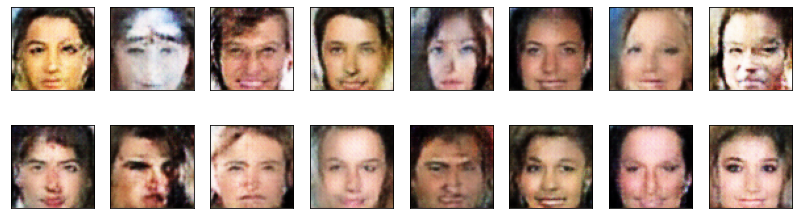

2025-11-14 22:19:34 | Epoch [38/50] | Batch 0/509 | d_loss: -2.7873 | g_loss: 5890.8267
2025-11-14 22:19:42 | Epoch [38/50] | Batch 50/509 | d_loss: -5.0271 | g_loss: 5902.5010
2025-11-14 22:19:50 | Epoch [38/50] | Batch 100/509 | d_loss: -3.7622 | g_loss: 5903.8184
2025-11-14 22:19:58 | Epoch [38/50] | Batch 150/509 | d_loss: -4.0961 | g_loss: 5905.3311
2025-11-14 22:20:06 | Epoch [38/50] | Batch 200/509 | d_loss: -5.2699 | g_loss: 5905.5518
2025-11-14 22:20:13 | Epoch [38/50] | Batch 250/509 | d_loss: -7.5335 | g_loss: 5907.5562
2025-11-14 22:20:21 | Epoch [38/50] | Batch 300/509 | d_loss: -6.8972 | g_loss: 5907.5586
2025-11-14 22:20:29 | Epoch [38/50] | Batch 350/509 | d_loss: -7.4345 | g_loss: 5897.4360
2025-11-14 22:20:37 | Epoch [38/50] | Batch 400/509 | d_loss: -6.5179 | g_loss: 5895.0874
2025-11-14 22:20:45 | Epoch [38/50] | Batch 450/509 | d_loss: -6.0061 | g_loss: 5902.2441
2025-11-14 22:20:52 | Epoch [38/50] | Batch 500/509 | d_loss: -6.2830 | g_loss: 5897.5928


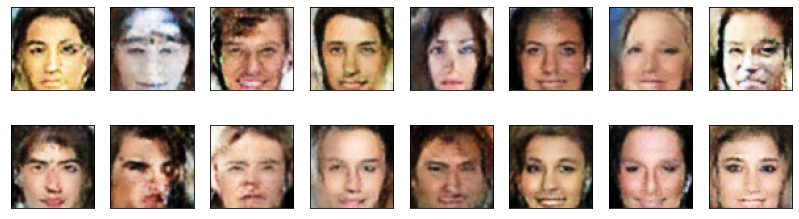

2025-11-14 22:20:55 | Epoch [39/50] | Batch 0/509 | d_loss: -6.5706 | g_loss: 5907.6064
2025-11-14 22:21:03 | Epoch [39/50] | Batch 50/509 | d_loss: -8.4477 | g_loss: 5893.0737
2025-11-14 22:21:11 | Epoch [39/50] | Batch 100/509 | d_loss: -4.5667 | g_loss: 5889.1699
2025-11-14 22:21:18 | Epoch [39/50] | Batch 150/509 | d_loss: -9.6341 | g_loss: 5891.8096
2025-11-14 22:21:26 | Epoch [39/50] | Batch 200/509 | d_loss: -7.3602 | g_loss: 5890.4990
2025-11-14 22:21:34 | Epoch [39/50] | Batch 250/509 | d_loss: -4.5429 | g_loss: 5874.6523
2025-11-14 22:21:42 | Epoch [39/50] | Batch 300/509 | d_loss: -7.8190 | g_loss: 5883.9966
2025-11-14 22:21:50 | Epoch [39/50] | Batch 350/509 | d_loss: -6.2836 | g_loss: 5881.2583
2025-11-14 22:21:58 | Epoch [39/50] | Batch 400/509 | d_loss: -7.2569 | g_loss: 5885.2686
2025-11-14 22:22:05 | Epoch [39/50] | Batch 450/509 | d_loss: -7.4381 | g_loss: 5879.9795
2025-11-14 22:22:13 | Epoch [39/50] | Batch 500/509 | d_loss: -4.4813 | g_loss: 5887.6270


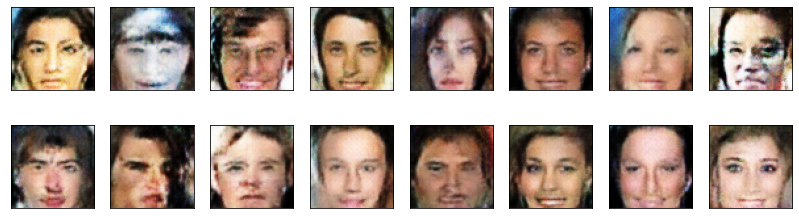

2025-11-14 22:22:16 | Epoch [40/50] | Batch 0/509 | d_loss: -8.2303 | g_loss: 5891.2949
2025-11-14 22:22:24 | Epoch [40/50] | Batch 50/509 | d_loss: -3.3736 | g_loss: 5862.8203
2025-11-14 22:22:31 | Epoch [40/50] | Batch 100/509 | d_loss: -5.8120 | g_loss: 5870.8232
2025-11-14 22:22:39 | Epoch [40/50] | Batch 150/509 | d_loss: -6.6533 | g_loss: 5882.8105
2025-11-14 22:22:47 | Epoch [40/50] | Batch 200/509 | d_loss: -7.2323 | g_loss: 5876.4688
2025-11-14 22:22:55 | Epoch [40/50] | Batch 250/509 | d_loss: -8.1218 | g_loss: 5872.0898
2025-11-14 22:23:03 | Epoch [40/50] | Batch 300/509 | d_loss: -9.4078 | g_loss: 5858.7505
2025-11-14 22:23:11 | Epoch [40/50] | Batch 350/509 | d_loss: -9.5865 | g_loss: 5860.1914
2025-11-14 22:23:18 | Epoch [40/50] | Batch 400/509 | d_loss: -7.3023 | g_loss: 5856.8633
2025-11-14 22:23:26 | Epoch [40/50] | Batch 450/509 | d_loss: -7.4419 | g_loss: 5867.4326
2025-11-14 22:23:34 | Epoch [40/50] | Batch 500/509 | d_loss: 13.6079 | g_loss: 5826.6719


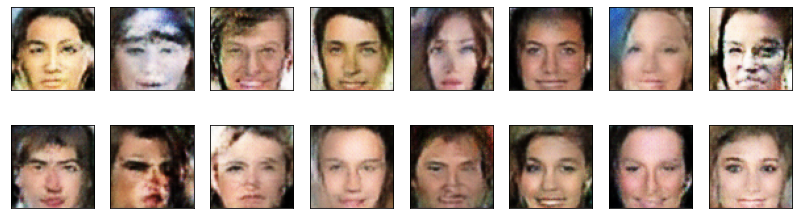

2025-11-14 22:23:37 | Epoch [41/50] | Batch 0/509 | d_loss: -1.5828 | g_loss: 5827.9258
2025-11-14 22:23:44 | Epoch [41/50] | Batch 50/509 | d_loss: -6.3122 | g_loss: 5849.6543
2025-11-14 22:23:52 | Epoch [41/50] | Batch 100/509 | d_loss: -5.9591 | g_loss: 5852.6533
2025-11-14 22:24:00 | Epoch [41/50] | Batch 150/509 | d_loss: -7.7738 | g_loss: 5858.2974
2025-11-14 22:24:08 | Epoch [41/50] | Batch 200/509 | d_loss: -3.1680 | g_loss: 5806.5894
2025-11-14 22:24:15 | Epoch [41/50] | Batch 250/509 | d_loss: -5.2371 | g_loss: 5824.2686
2025-11-14 22:24:23 | Epoch [41/50] | Batch 300/509 | d_loss: -4.7633 | g_loss: 5837.2056
2025-11-14 22:24:31 | Epoch [41/50] | Batch 350/509 | d_loss: -3.9611 | g_loss: 5841.2217
2025-11-14 22:24:39 | Epoch [41/50] | Batch 400/509 | d_loss: -4.8784 | g_loss: 5841.1367
2025-11-14 22:24:47 | Epoch [41/50] | Batch 450/509 | d_loss: -7.3153 | g_loss: 5844.4824
2025-11-14 22:24:55 | Epoch [41/50] | Batch 500/509 | d_loss: -5.5424 | g_loss: 5848.7905


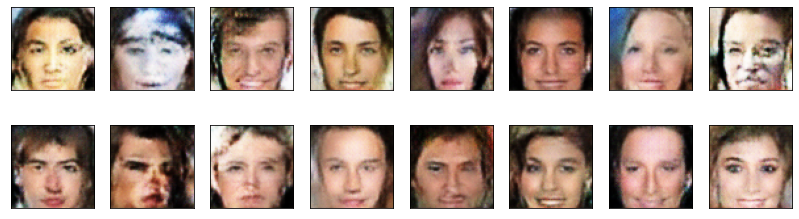

2025-11-14 22:24:57 | Epoch [42/50] | Batch 0/509 | d_loss: -6.4795 | g_loss: 5849.2754
2025-11-14 22:25:05 | Epoch [42/50] | Batch 50/509 | d_loss: -9.2040 | g_loss: 5845.3867
2025-11-14 22:25:13 | Epoch [42/50] | Batch 100/509 | d_loss: -7.7932 | g_loss: 5839.0605
2025-11-14 22:25:21 | Epoch [42/50] | Batch 150/509 | d_loss: -7.4132 | g_loss: 5838.4214
2025-11-14 22:25:28 | Epoch [42/50] | Batch 200/509 | d_loss: -4.4550 | g_loss: 5820.8677
2025-11-14 22:25:36 | Epoch [42/50] | Batch 250/509 | d_loss: 7.6660 | g_loss: 5755.4600
2025-11-14 22:25:44 | Epoch [42/50] | Batch 300/509 | d_loss: -2.8769 | g_loss: 5781.1885
2025-11-14 22:25:52 | Epoch [42/50] | Batch 350/509 | d_loss: -4.9232 | g_loss: 5793.0449
2025-11-14 22:26:00 | Epoch [42/50] | Batch 400/509 | d_loss: -5.4351 | g_loss: 5797.7622
2025-11-14 22:26:07 | Epoch [42/50] | Batch 450/509 | d_loss: -4.9187 | g_loss: 5811.0117
2025-11-14 22:26:15 | Epoch [42/50] | Batch 500/509 | d_loss: -5.7126 | g_loss: 5815.5537


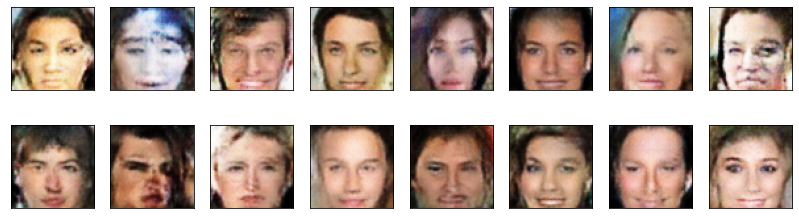

2025-11-14 22:26:18 | Epoch [43/50] | Batch 0/509 | d_loss: -4.0623 | g_loss: 5810.2422
2025-11-14 22:26:26 | Epoch [43/50] | Batch 50/509 | d_loss: -5.0221 | g_loss: 5811.1436
2025-11-14 22:26:34 | Epoch [43/50] | Batch 100/509 | d_loss: -6.4767 | g_loss: 5805.1147
2025-11-14 22:26:41 | Epoch [43/50] | Batch 150/509 | d_loss: -4.5642 | g_loss: 5813.2461
2025-11-14 22:26:49 | Epoch [43/50] | Batch 200/509 | d_loss: -6.3913 | g_loss: 5817.7148
2025-11-14 22:26:57 | Epoch [43/50] | Batch 250/509 | d_loss: -7.8122 | g_loss: 5811.8311
2025-11-14 22:27:04 | Epoch [43/50] | Batch 300/509 | d_loss: -5.9112 | g_loss: 5816.5879
2025-11-14 22:27:12 | Epoch [43/50] | Batch 350/509 | d_loss: -4.4878 | g_loss: 5820.8149
2025-11-14 22:27:20 | Epoch [43/50] | Batch 400/509 | d_loss: -7.2245 | g_loss: 5815.4355
2025-11-14 22:27:28 | Epoch [43/50] | Batch 450/509 | d_loss: -6.5295 | g_loss: 5812.0747
2025-11-14 22:27:36 | Epoch [43/50] | Batch 500/509 | d_loss: -8.0550 | g_loss: 5803.9814


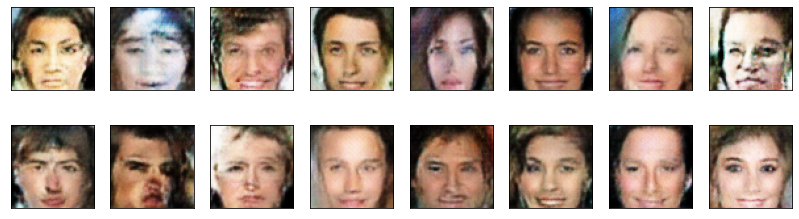

2025-11-14 22:27:39 | Epoch [44/50] | Batch 0/509 | d_loss: -7.9627 | g_loss: 5805.0728
2025-11-14 22:27:46 | Epoch [44/50] | Batch 50/509 | d_loss: -8.4087 | g_loss: 5810.0151
2025-11-14 22:27:54 | Epoch [44/50] | Batch 100/509 | d_loss: -3.1070 | g_loss: 5683.5674
2025-11-14 22:28:02 | Epoch [44/50] | Batch 150/509 | d_loss: -3.4203 | g_loss: 5705.4546
2025-11-14 22:28:10 | Epoch [44/50] | Batch 200/509 | d_loss: -4.9303 | g_loss: 5711.1553
2025-11-14 22:28:18 | Epoch [44/50] | Batch 250/509 | d_loss: -3.3944 | g_loss: 5721.6680
2025-11-14 22:28:26 | Epoch [44/50] | Batch 300/509 | d_loss: -5.1879 | g_loss: 5725.1104
2025-11-14 22:28:33 | Epoch [44/50] | Batch 350/509 | d_loss: -4.6283 | g_loss: 5732.7744
2025-11-14 22:28:41 | Epoch [44/50] | Batch 400/509 | d_loss: -4.8541 | g_loss: 5741.5879
2025-11-14 22:28:49 | Epoch [44/50] | Batch 450/509 | d_loss: -4.0209 | g_loss: 5740.6875
2025-11-14 22:28:57 | Epoch [44/50] | Batch 500/509 | d_loss: -3.9942 | g_loss: 5743.0586


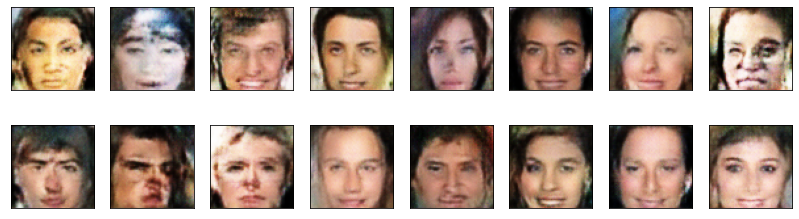

2025-11-14 22:29:00 | Epoch [45/50] | Batch 0/509 | d_loss: -4.3130 | g_loss: 5744.2734
2025-11-14 22:29:07 | Epoch [45/50] | Batch 50/509 | d_loss: -4.8174 | g_loss: 5741.4160
2025-11-14 22:29:15 | Epoch [45/50] | Batch 100/509 | d_loss: -6.5637 | g_loss: 5745.9609
2025-11-14 22:29:23 | Epoch [45/50] | Batch 150/509 | d_loss: -4.8179 | g_loss: 5751.6182
2025-11-14 22:29:31 | Epoch [45/50] | Batch 200/509 | d_loss: -5.6245 | g_loss: 5750.5576
2025-11-14 22:29:39 | Epoch [45/50] | Batch 250/509 | d_loss: -4.6251 | g_loss: 5753.7910
2025-11-14 22:29:47 | Epoch [45/50] | Batch 300/509 | d_loss: -5.3307 | g_loss: 5747.7124
2025-11-14 22:29:54 | Epoch [45/50] | Batch 350/509 | d_loss: -4.4719 | g_loss: 5750.1060
2025-11-14 22:30:02 | Epoch [45/50] | Batch 400/509 | d_loss: -4.7981 | g_loss: 5762.4893
2025-11-14 22:30:10 | Epoch [45/50] | Batch 450/509 | d_loss: -6.0163 | g_loss: 5757.9668
2025-11-14 22:30:17 | Epoch [45/50] | Batch 500/509 | d_loss: -4.5486 | g_loss: 5755.9727


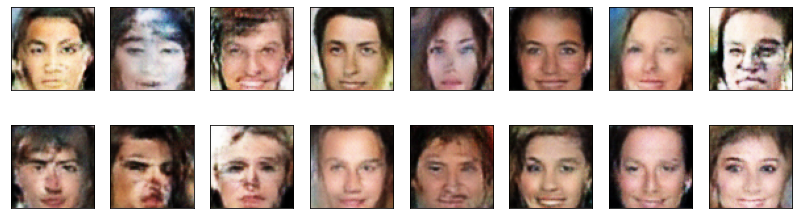

2025-11-14 22:30:21 | Epoch [46/50] | Batch 0/509 | d_loss: -6.2196 | g_loss: 5760.1860
2025-11-14 22:30:28 | Epoch [46/50] | Batch 50/509 | d_loss: -7.0643 | g_loss: 5748.6123
2025-11-14 22:30:36 | Epoch [46/50] | Batch 100/509 | d_loss: -5.9031 | g_loss: 5756.4175
2025-11-14 22:30:44 | Epoch [46/50] | Batch 150/509 | d_loss: -5.2831 | g_loss: 5756.2666
2025-11-14 22:30:52 | Epoch [46/50] | Batch 200/509 | d_loss: -4.0782 | g_loss: 5759.1885
2025-11-14 22:30:59 | Epoch [46/50] | Batch 250/509 | d_loss: -8.6511 | g_loss: 5758.6963
2025-11-14 22:31:07 | Epoch [46/50] | Batch 300/509 | d_loss: -4.6075 | g_loss: 5754.3076
2025-11-14 22:31:15 | Epoch [46/50] | Batch 350/509 | d_loss: -5.7919 | g_loss: 5755.5215
2025-11-14 22:31:23 | Epoch [46/50] | Batch 400/509 | d_loss: -6.4784 | g_loss: 5751.4746
2025-11-14 22:31:31 | Epoch [46/50] | Batch 450/509 | d_loss: -3.1695 | g_loss: 5745.9072
2025-11-14 22:31:39 | Epoch [46/50] | Batch 500/509 | d_loss: -5.7960 | g_loss: 5759.7158


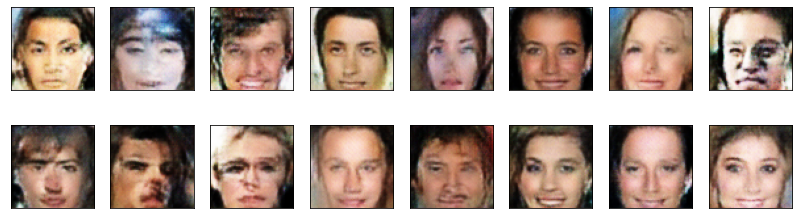

2025-11-14 22:31:42 | Epoch [47/50] | Batch 0/509 | d_loss: -6.8428 | g_loss: 5742.5205
2025-11-14 22:31:49 | Epoch [47/50] | Batch 50/509 | d_loss: -6.7598 | g_loss: 5759.9795
2025-11-14 22:31:57 | Epoch [47/50] | Batch 100/509 | d_loss: -4.5667 | g_loss: 5747.5952
2025-11-14 22:32:05 | Epoch [47/50] | Batch 150/509 | d_loss: -7.3404 | g_loss: 5743.1504
2025-11-14 22:32:13 | Epoch [47/50] | Batch 200/509 | d_loss: -7.0446 | g_loss: 5734.6533
2025-11-14 22:32:21 | Epoch [47/50] | Batch 250/509 | d_loss: -6.0584 | g_loss: 5748.4775
2025-11-14 22:32:29 | Epoch [47/50] | Batch 300/509 | d_loss: -3.4839 | g_loss: 5707.0771
2025-11-14 22:32:36 | Epoch [47/50] | Batch 350/509 | d_loss: -5.0989 | g_loss: 5726.4321
2025-11-14 22:32:44 | Epoch [47/50] | Batch 400/509 | d_loss: -5.5917 | g_loss: 5737.1055
2025-11-14 22:32:52 | Epoch [47/50] | Batch 450/509 | d_loss: -6.2563 | g_loss: 5737.3325
2025-11-14 22:33:00 | Epoch [47/50] | Batch 500/509 | d_loss: -7.0565 | g_loss: 5743.3179


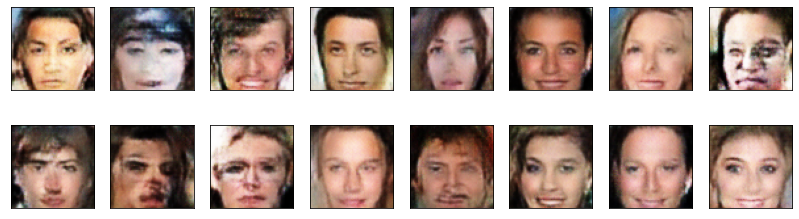

2025-11-14 22:33:03 | Epoch [48/50] | Batch 0/509 | d_loss: -5.2418 | g_loss: 5743.4229
2025-11-14 22:33:10 | Epoch [48/50] | Batch 50/509 | d_loss: -7.9763 | g_loss: 5742.3975
2025-11-14 22:33:18 | Epoch [48/50] | Batch 100/509 | d_loss: -6.9613 | g_loss: 5740.4658
2025-11-14 22:33:26 | Epoch [48/50] | Batch 150/509 | d_loss: -9.1813 | g_loss: 5729.2373
2025-11-14 22:33:34 | Epoch [48/50] | Batch 200/509 | d_loss: -9.0462 | g_loss: 5749.6465
2025-11-14 22:33:41 | Epoch [48/50] | Batch 250/509 | d_loss: -6.7613 | g_loss: 5737.6240
2025-11-14 22:33:49 | Epoch [48/50] | Batch 300/509 | d_loss: -4.2619 | g_loss: 5726.7236
2025-11-14 22:33:57 | Epoch [48/50] | Batch 350/509 | d_loss: -5.3600 | g_loss: 5738.1533
2025-11-14 22:34:05 | Epoch [48/50] | Batch 400/509 | d_loss: -7.2261 | g_loss: 5740.6973
2025-11-14 22:34:12 | Epoch [48/50] | Batch 450/509 | d_loss: -4.7615 | g_loss: 5719.0425
2025-11-14 22:34:20 | Epoch [48/50] | Batch 500/509 | d_loss: -7.4129 | g_loss: 5737.9424


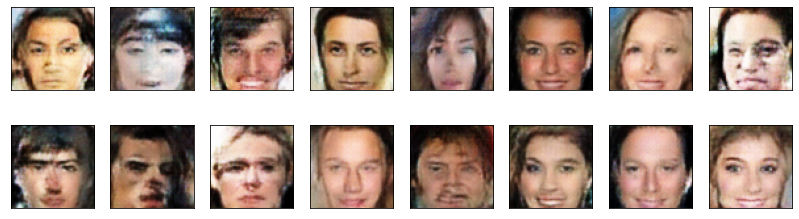

2025-11-14 22:34:23 | Epoch [49/50] | Batch 0/509 | d_loss: -6.7118 | g_loss: 5726.5029
2025-11-14 22:34:31 | Epoch [49/50] | Batch 50/509 | d_loss: -7.3929 | g_loss: 5724.7812
2025-11-14 22:34:39 | Epoch [49/50] | Batch 100/509 | d_loss: -0.5345 | g_loss: 5706.7939
2025-11-14 22:34:46 | Epoch [49/50] | Batch 150/509 | d_loss: -2.1853 | g_loss: 5695.1523
2025-11-14 22:34:54 | Epoch [49/50] | Batch 200/509 | d_loss: -2.4699 | g_loss: 5694.8613
2025-11-14 22:35:02 | Epoch [49/50] | Batch 250/509 | d_loss: -2.1339 | g_loss: 5690.0083
2025-11-14 22:35:10 | Epoch [49/50] | Batch 300/509 | d_loss: -3.4390 | g_loss: 5696.9653
2025-11-14 22:35:18 | Epoch [49/50] | Batch 350/509 | d_loss: -3.8342 | g_loss: 5706.6504
2025-11-14 22:35:26 | Epoch [49/50] | Batch 400/509 | d_loss: -3.2757 | g_loss: 5707.4634
2025-11-14 22:35:33 | Epoch [49/50] | Batch 450/509 | d_loss: -2.6749 | g_loss: 5710.9297
2025-11-14 22:35:41 | Epoch [49/50] | Batch 500/509 | d_loss: -3.8894 | g_loss: 5706.1235


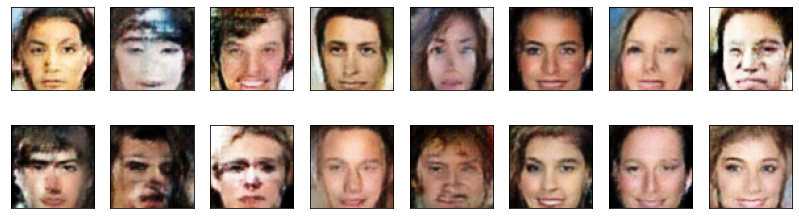

2025-11-14 22:35:44 | Epoch [50/50] | Batch 0/509 | d_loss: -4.4578 | g_loss: 5713.3154
2025-11-14 22:35:52 | Epoch [50/50] | Batch 50/509 | d_loss: -3.8986 | g_loss: 5709.0107
2025-11-14 22:35:59 | Epoch [50/50] | Batch 100/509 | d_loss: -3.5905 | g_loss: 5701.2954
2025-11-14 22:36:07 | Epoch [50/50] | Batch 150/509 | d_loss: -4.9190 | g_loss: 5706.2861
2025-11-14 22:36:15 | Epoch [50/50] | Batch 200/509 | d_loss: -4.0537 | g_loss: 5703.7749
2025-11-14 22:36:23 | Epoch [50/50] | Batch 250/509 | d_loss: -5.3356 | g_loss: 5700.0557
2025-11-14 22:36:31 | Epoch [50/50] | Batch 300/509 | d_loss: -5.7557 | g_loss: 5705.4536
2025-11-14 22:36:38 | Epoch [50/50] | Batch 350/509 | d_loss: -5.6877 | g_loss: 5707.4434
2025-11-14 22:36:46 | Epoch [50/50] | Batch 400/509 | d_loss: -4.6228 | g_loss: 5699.3511
2025-11-14 22:36:54 | Epoch [50/50] | Batch 450/509 | d_loss: -5.0400 | g_loss: 5704.7051
2025-11-14 22:37:02 | Epoch [50/50] | Batch 500/509 | d_loss: -5.6665 | g_loss: 5705.5830


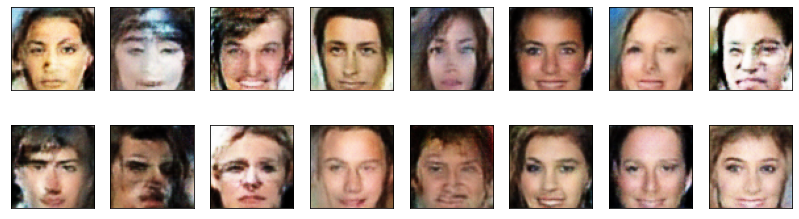

In [27]:
from datetime import datetime  # add once per runtime

fixed_latent_vector = torch.randn(16, latent_dim, 1, 1, device=device)

losses = []
n_critic = 5
g_loss = {'loss': torch.tensor(0.0, device=device)}
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)
        batch_sz = real_images.size(0)

        ####################################

        # TODO: implement the training strategy
        d_loss = discriminator_step(batch_sz, latent_dim, real_images)
        if batch_i % n_critic == 0:
            g_loss = generator_step(batch_sz, latent_dim)

        ####################################

        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')

    # display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()


### Training losses

Plot the training losses for the generator and discriminator.

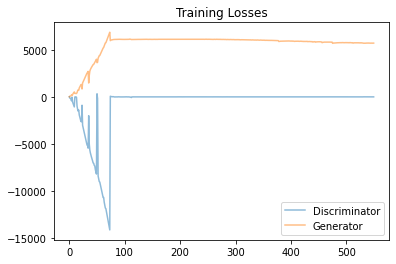

In [29]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** After 50 epochs the generator produces recognizable celebrity-like faces (eyes, hair, skin tones) but many samples still show warped facial geometry, asymmetrical eyes, or washed-out textures. This is consistent with the loss curves where the critic quickly dominates then plateaus around zero while the generator loss stays very high (>5k). This suggests the discriminator stops providing strong gradients, so the generator memorizes coarse features but fails to refine details. Also, it appears that dataset selection was in fact, biased, since the celebrity faces do not represent minorities in the given output. Some of the facial features between stereotypical masculine/feminine profiles also seem blended, possibly indicating the models try to balance/merge all features instead of understanding potential phenotypes (i.e., classical GAN is not good at semantic information tasks). 

To improve results I would (1) balance the adversaries by lowering the critic learning rate or reducing `n_critic` so G gets updates more frequently, (2) increase training time and/or model capacity (more channels or residual blocks) so the generator can model higher-frequency details, and (3) diversify regularization, e.g., tune the gradient-penalty weight, add instance noise, or use spectral normalization?to keep discriminator gradients informative. Because CelebA is biased toward lighter-skinned celebrities, augmenting with more diverse faces (or doing targeted augmentations/histogram equalization) would also help the model generalize beyond the narrow demographic seen in the current samples. Pragmatically, I would use a more modern approach to synthetic facial generation instead of only using classical GAN, unless I wanted to make video game sprites (the facial icons are reminiscent of PlayStation era character icons).


### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.